# Image Captioning with RNNs
In this exercise you will implement a vanilla recurrent neural networks and use them it to train a model that can generate novel captions for images.

In [1]:
# As usual, a bit of setup
from __future__ import print_function
import time, os, json
import numpy as np
import matplotlib.pyplot as plt

from cs231n.gradient_check import eval_numerical_gradient, eval_numerical_gradient_array
from cs231n.rnn_layers import *
from cs231n.captioning_solver import CaptioningSolver
from cs231n.classifiers.rnn import CaptioningRNN
from cs231n.coco_utils import load_coco_data, sample_coco_minibatch, decode_captions
from cs231n.image_utils import image_from_url

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

# for auto-reloading external modules
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%load_ext autoreload
%autoreload 2

def rel_error(x, y):
    """ returns relative error """
    return np.max(np.abs(x - y) / (np.maximum(1e-8, np.abs(x) + np.abs(y))))

## Install h5py
The COCO dataset we will be using is stored in HDF5 format. To load HDF5 files, we will need to install the `h5py` Python package. From the command line, run: <br/>
`pip install h5py`  <br/>
If you receive a permissions error, you may need to run the command as root: <br/>
```sudo pip install h5py```

You can also run commands directly from the Jupyter notebook by prefixing the command with the "!" character:

In [2]:
!pip install h5py

# Microsoft COCO
For this exercise we will use the 2014 release of the [Microsoft COCO dataset](http://mscoco.org/) which has become the standard testbed for image captioning. The dataset consists of 80,000 training images and 40,000 validation images, each annotated with 5 captions written by workers on Amazon Mechanical Turk.

You should have already downloaded the data by changing to the `cs231n/datasets` directory and running the script `get_assignment3_data.sh`. If you haven't yet done so, run that script now. Warning: the COCO data download is ~1GB.

We have preprocessed the data and extracted features for you already. For all images we have extracted features from the fc7 layer of the VGG-16 network pretrained on ImageNet; these features are stored in the files `train2014_vgg16_fc7.h5` and `val2014_vgg16_fc7.h5` respectively. To cut down on processing time and memory requirements, we have reduced the dimensionality of the features from 4096 to 512; these features can be found in the files `train2014_vgg16_fc7_pca.h5` and `val2014_vgg16_fc7_pca.h5`.

The raw images take up a lot of space (nearly 20GB) so we have not included them in the download. However all images are taken from Flickr, and URLs of the training and validation images are stored in the files `train2014_urls.txt` and `val2014_urls.txt` respectively. This allows you to download images on the fly for visualization. Since images are downloaded on-the-fly, **you must be connected to the internet to view images**.

Dealing with strings is inefficient, so we will work with an encoded version of the captions. Each word is assigned an integer ID, allowing us to represent a caption by a sequence of integers. The mapping between integer IDs and words is in the file `coco2014_vocab.json`, and you can use the function `decode_captions` from the file `cs231n/coco_utils.py` to convert numpy arrays of integer IDs back into strings.

There are a couple special tokens that we add to the vocabulary. We prepend a special `<START>` token and append an `<END>` token to the beginning and end of each caption respectively. Rare words are replaced with a special `<UNK>` token (for "unknown"). In addition, since we want to train with minibatches containing captions of different lengths, we pad short captions with a special `<NULL>` token after the `<END>` token and don't compute loss or gradient for `<NULL>` tokens. Since they are a bit of a pain, we have taken care of all implementation details around special tokens for you.

You can load all of the MS-COCO data (captions, features, URLs, and vocabulary) using the `load_coco_data` function from the file `cs231n/coco_utils.py`. Run the following cell to do so:

In [3]:
# Load COCO data from disk; this returns a dictionary
# We'll work with dimensionality-reduced features for this notebook, but feel
# free to experiment with the original features by changing the flag below.
data = load_coco_data(pca_features=True)

# Print out all the keys and values from the data dictionary
for k, v in data.items():
    if type(v) == np.ndarray:
        print(k, type(v), v.shape, v.dtype)
    else:
        print(k, type(v), len(v))

train_captions <class 'numpy.ndarray'> (400135, 17) int32
train_image_idxs <class 'numpy.ndarray'> (400135,) int32
val_captions <class 'numpy.ndarray'> (195954, 17) int32
val_image_idxs <class 'numpy.ndarray'> (195954,) int32
train_features <class 'numpy.ndarray'> (82783, 512) float32
val_features <class 'numpy.ndarray'> (40504, 512) float32
idx_to_word <class 'list'> 1004
word_to_idx <class 'dict'> 1004
train_urls <class 'numpy.ndarray'> (82783,) <U63
val_urls <class 'numpy.ndarray'> (40504,) <U63


## Look at the data
It is always a good idea to look at examples from the dataset before working with it.

You can use the `sample_coco_minibatch` function from the file `cs231n/coco_utils.py` to sample minibatches of data from the data structure returned from `load_coco_data`. Run the following to sample a small minibatch of training data and show the images and their captions. Running it multiple times and looking at the results helps you to get a sense of the dataset.

Note that we decode the captions using the `decode_captions` function and that we download the images on-the-fly using their Flickr URL, so **you must be connected to the internet to view images**.

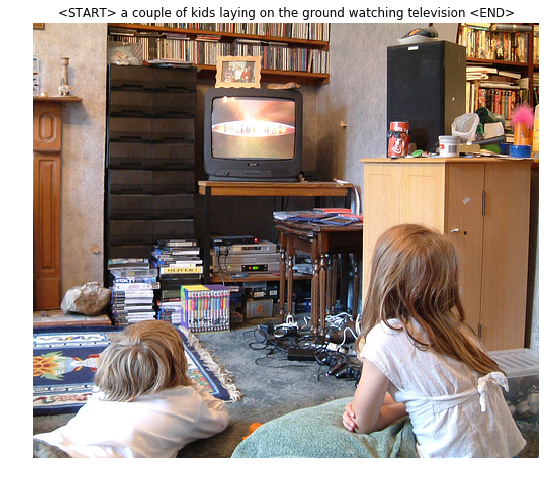

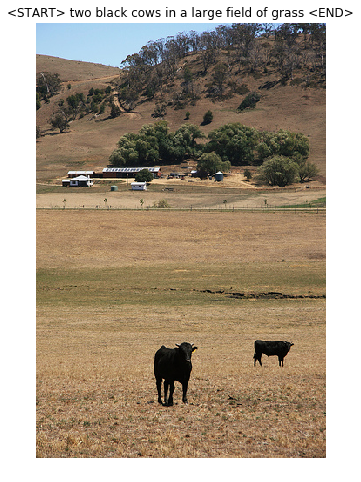

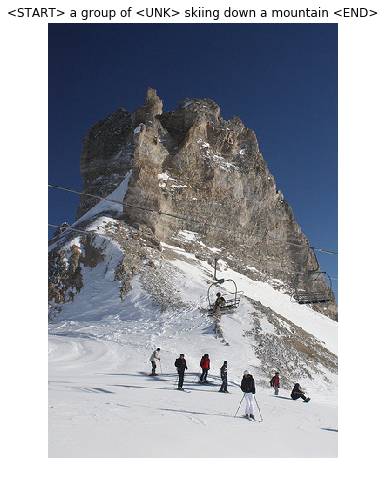

In [4]:
# Sample a minibatch and show the images and captions
batch_size = 3

captions, features, urls = sample_coco_minibatch(data, batch_size=batch_size)
for i, (caption, url) in enumerate(zip(captions, urls)):
    plt.imshow(image_from_url(url))
    plt.axis('off')
    caption_str = decode_captions(caption, data['idx_to_word'])
    plt.title(caption_str)
    plt.show()

# Recurrent Neural Networks
As discussed in lecture, we will use recurrent neural network (RNN) language models for image captioning. The file `cs231n/rnn_layers.py` contains implementations of different layer types that are needed for recurrent neural networks, and the file `cs231n/classifiers/rnn.py` uses these layers to implement an image captioning model.

We will first implement different types of RNN layers in `cs231n/rnn_layers.py`.

# Vanilla RNN: step forward
Open the file `cs231n/rnn_layers.py`. This file implements the forward and backward passes for different types of layers that are commonly used in recurrent neural networks.

First implement the function `rnn_step_forward` which implements the forward pass for a single timestep of a vanilla recurrent neural network. After doing so run the following to check your implementation. You should see errors less than 1e-8.

In [5]:
N, D, H = 3, 10, 4

x = np.linspace(-0.4, 0.7, num=N*D).reshape(N, D)
prev_h = np.linspace(-0.2, 0.5, num=N*H).reshape(N, H)
Wx = np.linspace(-0.1, 0.9, num=D*H).reshape(D, H)
Wh = np.linspace(-0.3, 0.7, num=H*H).reshape(H, H)
b = np.linspace(-0.2, 0.4, num=H)

next_h, _ = rnn_step_forward(x, prev_h, Wx, Wh, b)
expected_next_h = np.asarray([
  [-0.58172089, -0.50182032, -0.41232771, -0.31410098],
  [ 0.66854692,  0.79562378,  0.87755553,  0.92795967],
  [ 0.97934501,  0.99144213,  0.99646691,  0.99854353]])

print('next_h error: ', rel_error(expected_next_h, next_h))

next_h error:  6.29242142647e-09


# Vanilla RNN: step backward
In the file `cs231n/rnn_layers.py` implement the `rnn_step_backward` function. After doing so run the following to numerically gradient check your implementation. You should see errors less than `1e-8`.

In [10]:
from cs231n.rnn_layers import rnn_step_forward, rnn_step_backward
np.random.seed(231)
N, D, H = 4, 5, 6
x = np.random.randn(N, D)
h = np.random.randn(N, H)
Wx = np.random.randn(D, H)
Wh = np.random.randn(H, H)
b = np.random.randn(H)

out, cache = rnn_step_forward(x, h, Wx, Wh, b)

dnext_h = np.random.randn(*out.shape)

fx = lambda x: rnn_step_forward(x, h, Wx, Wh, b)[0]
fh = lambda prev_h: rnn_step_forward(x, h, Wx, Wh, b)[0]
fWx = lambda Wx: rnn_step_forward(x, h, Wx, Wh, b)[0]
fWh = lambda Wh: rnn_step_forward(x, h, Wx, Wh, b)[0]
fb = lambda b: rnn_step_forward(x, h, Wx, Wh, b)[0]

dx_num = eval_numerical_gradient_array(fx, x, dnext_h)
dprev_h_num = eval_numerical_gradient_array(fh, h, dnext_h)
dWx_num = eval_numerical_gradient_array(fWx, Wx, dnext_h)
dWh_num = eval_numerical_gradient_array(fWh, Wh, dnext_h)
db_num = eval_numerical_gradient_array(fb, b, dnext_h)

dx, dprev_h, dWx, dWh, db = rnn_step_backward(dnext_h, cache)

print('dx error: ', rel_error(dx_num, dx))
print('dprev_h error: ', rel_error(dprev_h_num, dprev_h))
print('dWx error: ', rel_error(dWx_num, dWx))
print('dWh error: ', rel_error(dWh_num, dWh))
print('db error: ', rel_error(db_num, db))

[[-0.42468074 -0.33171457  0.23544042 -0.11767831  0.06265891]
 [ 2.18865324  0.56431769  1.87360658  0.82963201  0.01519562]
 [ 0.29041323 -0.46363273  1.87908444  1.6613161   0.70544412]
 [ 0.6794582  -2.89526149 -0.57497782 -2.01252357  0.46188604]] [[ 0.42888112  0.4262797   0.17006432  0.44913714  0.15018021  0.15312793]
 [-0.83739752 -1.05091584  0.70870706 -0.34849886  0.78257161 -0.84748695]
 [ 0.43582344 -0.36097978  2.9683717   0.11926203  0.65324442 -0.46183079]
 [ 1.83762542 -0.46207535 -1.99674212  1.8257034   1.64608453 -0.32467915]] [[-0.33880209  1.07059455  0.21370108 -0.37847202  0.72594411 -1.5683991 ]
 [-0.24753083 -0.12893996 -0.3969625   0.16910454 -0.12978493 -0.88030298]
 [-0.00976975  1.59135419  0.88023686 -0.96010078 -0.52378935  2.86878799]
 [ 0.09683985  0.15910002 -0.67232789  0.01672118  0.18633907 -1.61038787]
 [-0.45490204  2.00062397 -1.03469364 -0.79119714 -0.73433009 -1.18417464]] [[ 0.39840566 -1.728837    0.5410833   0.7094992   0.43049826  0.74650

# Vanilla RNN: forward
Now that you have implemented the forward and backward passes for a single timestep of a vanilla RNN, you will combine these pieces to implement a RNN that process an entire sequence of data.

In the file `cs231n/rnn_layers.py`, implement the function `rnn_forward`. This should be implemented using the `rnn_step_forward` function that you defined above. After doing so run the following to check your implementation. You should see errors less than `1e-7`.

In [12]:
N, T, D, H = 2, 3, 4, 5

x = np.linspace(-0.1, 0.3, num=N*T*D).reshape(N, T, D)
h0 = np.linspace(-0.3, 0.1, num=N*H).reshape(N, H)
Wx = np.linspace(-0.2, 0.4, num=D*H).reshape(D, H)
Wh = np.linspace(-0.4, 0.1, num=H*H).reshape(H, H)
b = np.linspace(-0.7, 0.1, num=H)

h, _ = rnn_forward(x, h0, Wx, Wh, b)
expected_h = np.asarray([
  [
    [-0.42070749, -0.27279261, -0.11074945,  0.05740409,  0.22236251],
    [-0.39525808, -0.22554661, -0.0409454,   0.14649412,  0.32397316],
    [-0.42305111, -0.24223728, -0.04287027,  0.15997045,  0.35014525],
  ],
  [
    [-0.55857474, -0.39065825, -0.19198182,  0.02378408,  0.23735671],
    [-0.27150199, -0.07088804,  0.13562939,  0.33099728,  0.50158768],
    [-0.51014825, -0.30524429, -0.06755202,  0.17806392,  0.40333043]]])
print('h error: ', rel_error(expected_h, h))

h error:  7.72846618019e-08


# Vanilla RNN: backward
In the file `cs231n/rnn_layers.py`, implement the backward pass for a vanilla RNN in the function `rnn_backward`. This should run back-propagation over the entire sequence, calling into the `rnn_step_backward` function that you defined above. You should see errors less than 5e-7.

In [13]:
np.random.seed(231)

N, D, T, H = 2, 3, 10, 5

x = np.random.randn(N, T, D)
h0 = np.random.randn(N, H)
Wx = np.random.randn(D, H)
Wh = np.random.randn(H, H)
b = np.random.randn(H)

out, cache = rnn_forward(x, h0, Wx, Wh, b)

dout = np.random.randn(*out.shape)

dx, dh0, dWx, dWh, db = rnn_backward(dout, cache)

fx = lambda x: rnn_forward(x, h0, Wx, Wh, b)[0]
fh0 = lambda h0: rnn_forward(x, h0, Wx, Wh, b)[0]
fWx = lambda Wx: rnn_forward(x, h0, Wx, Wh, b)[0]
fWh = lambda Wh: rnn_forward(x, h0, Wx, Wh, b)[0]
fb = lambda b: rnn_forward(x, h0, Wx, Wh, b)[0]

dx_num = eval_numerical_gradient_array(fx, x, dout)
dh0_num = eval_numerical_gradient_array(fh0, h0, dout)
dWx_num = eval_numerical_gradient_array(fWx, Wx, dout)
dWh_num = eval_numerical_gradient_array(fWh, Wh, dout)
db_num = eval_numerical_gradient_array(fb, b, dout)

print('dx error: ', rel_error(dx_num, dx))
print('dh0 error: ', rel_error(dh0_num, dh0))
print('dWx error: ', rel_error(dWx_num, dWx))
print('dWh error: ', rel_error(dWh_num, dWh))
print('db error: ', rel_error(db_num, db))

[[-0.13977295  0.50171978 -0.66358187]
 [ 0.11682316  1.61469799  0.24655484]] [[ 1.06399753  0.66373649  0.60429733 -0.47273123  0.08488759]
 [ 0.76982968  1.42245842 -0.78146114  0.97391792  0.12575529]] [[-0.57225856 -0.08668722  1.61648254  0.27350147  0.02343133]
 [-0.34565029  0.21660029  0.88253794 -0.11165318 -0.25974332]
 [-0.51519046  0.29556297  1.32493656 -0.1383394  -0.35936689]] [[ 0.49244195 -0.11739197 -1.32404039 -0.03773357  0.17534841]
 [ 0.21266816 -0.02091869 -0.58219514 -0.04694815  0.04540153]
 [ 0.49416633  0.24612973 -1.45564552 -0.41247545 -0.19464902]
 [ 0.49348932  0.24151998 -1.45216069 -0.40751246 -0.19003139]
 [-0.49133346  0.16321155  1.30498224 -0.00978719 -0.22188323]] [ 0.49623004  0.24904025 -1.46238132 -0.41613588 -0.19737909]
[[ 0.09329074 -0.95755304  0.4641419 ]
 [-0.30664304 -0.30879541 -0.43980021]] [[ 0.86681457  0.72273585  2.29468214 -1.78629945  0.43084753]
 [ 0.22760796  0.06880307  0.52715151 -1.20237342  0.15892814]] [[ -1.77482765e-01  

# Word embedding: forward
In deep learning systems, we commonly represent words using vectors. Each word of the vocabulary will be associated with a vector, and these vectors will be learned jointly with the rest of the system.

In the file `cs231n/rnn_layers.py`, implement the function `word_embedding_forward` to convert words (represented by integers) into vectors. Run the following to check your implementation. You should see error around `1e-8`.

In [15]:
N, T, V, D = 2, 4, 5, 3

x = np.asarray([[0, 3, 1, 2], [2, 1, 0, 3]])
W = np.linspace(0, 1, num=V*D).reshape(V, D)

out, _ = word_embedding_forward(x, W)
expected_out = np.asarray([
 [[ 0.,          0.07142857,  0.14285714],
  [ 0.64285714,  0.71428571,  0.78571429],
  [ 0.21428571,  0.28571429,  0.35714286],
  [ 0.42857143,  0.5,         0.57142857]],
 [[ 0.42857143,  0.5,         0.57142857],
  [ 0.21428571,  0.28571429,  0.35714286],
  [ 0.,          0.07142857,  0.14285714],
  [ 0.64285714,  0.71428571,  0.78571429]]])

print('out error: ', rel_error(expected_out, out))

out error:  1.00000000947e-08


# Word embedding: backward
Implement the backward pass for the word embedding function in the function `word_embedding_backward`. After doing so run the following to numerically gradient check your implementation. You should see errors less than `1e-11`.

In [16]:
np.random.seed(231)

N, T, V, D = 50, 3, 5, 6
x = np.random.randint(V, size=(N, T))
W = np.random.randn(V, D)

out, cache = word_embedding_forward(x, W)
dout = np.random.randn(*out.shape)
dW = word_embedding_backward(dout, cache)

f = lambda W: word_embedding_forward(x, W)[0]
dW_num = eval_numerical_gradient_array(f, W, dout)

print('dW error: ', rel_error(dW, dW_num))

dW error:  3.27745956931e-12


# Temporal Affine layer
At every timestep we use an affine function to transform the RNN hidden vector at that timestep into scores for each word in the vocabulary. Because this is very similar to the affine layer that you implemented in assignment 2, we have provided this function for you in the `temporal_affine_forward` and `temporal_affine_backward` functions in the file `cs231n/rnn_layers.py`. Run the following to perform numeric gradient checking on the implementation. You should see errors less than 1e-9.

In [17]:
np.random.seed(231)

# Gradient check for temporal affine layer
N, T, D, M = 2, 3, 4, 5
x = np.random.randn(N, T, D)
w = np.random.randn(D, M)
b = np.random.randn(M)

out, cache = temporal_affine_forward(x, w, b)

dout = np.random.randn(*out.shape)

fx = lambda x: temporal_affine_forward(x, w, b)[0]
fw = lambda w: temporal_affine_forward(x, w, b)[0]
fb = lambda b: temporal_affine_forward(x, w, b)[0]

dx_num = eval_numerical_gradient_array(fx, x, dout)
dw_num = eval_numerical_gradient_array(fw, w, dout)
db_num = eval_numerical_gradient_array(fb, b, dout)

dx, dw, db = temporal_affine_backward(dout, cache)

print('dx error: ', rel_error(dx_num, dx))
print('dw error: ', rel_error(dw_num, dw))
print('db error: ', rel_error(db_num, db))

dx error:  3.49087330919e-10
dw error:  1.5772169136e-10
db error:  3.27565351597e-12


# Temporal Softmax loss
In an RNN language model, at every timestep we produce a score for each word in the vocabulary. We know the ground-truth word at each timestep, so we use a softmax loss function to compute loss and gradient at each timestep. We sum the losses over time and average them over the minibatch.

However there is one wrinkle: since we operate over minibatches and different captions may have different lengths, we append `<NULL>` tokens to the end of each caption so they all have the same length. We don't want these `<NULL>` tokens to count toward the loss or gradient, so in addition to scores and ground-truth labels our loss function also accepts a `mask` array that tells it which elements of the scores count towards the loss.

Since this is very similar to the softmax loss function you implemented in assignment 1, we have implemented this loss function for you; look at the `temporal_softmax_loss` function in the file `cs231n/rnn_layers.py`.

Run the following cell to sanity check the loss and perform numeric gradient checking on the function. You should see an error for dx less than 1e-7.

In [18]:
# Sanity check for temporal softmax loss
from cs231n.rnn_layers import temporal_softmax_loss

N, T, V = 100, 1, 10

def check_loss(N, T, V, p):
    x = 0.001 * np.random.randn(N, T, V)
    y = np.random.randint(V, size=(N, T))
    mask = np.random.rand(N, T) <= p
    print(temporal_softmax_loss(x, y, mask)[0])
  
check_loss(100, 1, 10, 1.0)   # Should be about 2.3
check_loss(100, 10, 10, 1.0)  # Should be about 23
check_loss(5000, 10, 10, 0.1) # Should be about 2.3

# Gradient check for temporal softmax loss
N, T, V = 7, 8, 9

x = np.random.randn(N, T, V)
y = np.random.randint(V, size=(N, T))
mask = (np.random.rand(N, T) > 0.5)

loss, dx = temporal_softmax_loss(x, y, mask, verbose=False)

dx_num = eval_numerical_gradient(lambda x: temporal_softmax_loss(x, y, mask)[0], x, verbose=False)

print('dx error: ', rel_error(dx, dx_num))

2.30277817743
23.0259859531
2.26436117903
dx error:  2.58358530352e-08


# RNN for image captioning
Now that you have implemented the necessary layers, you can combine them to build an image captioning model. Open the file `cs231n/classifiers/rnn.py` and look at the `CaptioningRNN` class.

Implement the forward and backward pass of the model in the `loss` function. For now you only need to implement the case where `cell_type='rnn'` for vanialla RNNs; you will implement the LSTM case later. After doing so, run the following to check your forward pass using a small test case; you should see error less than `1e-10`.

In [20]:
N, D, W, H = 10, 20, 30, 40
word_to_idx = {'<NULL>': 0, 'cat': 2, 'dog': 3}
V = len(word_to_idx)
T = 13

model = CaptioningRNN(word_to_idx,
          input_dim=D,
          wordvec_dim=W,
          hidden_dim=H,
          cell_type='rnn',
          dtype=np.float64)

# Set all model parameters to fixed values
for k, v in model.params.items():
    model.params[k] = np.linspace(-1.4, 1.3, num=v.size).reshape(*v.shape)

features = np.linspace(-1.5, 0.3, num=(N * D)).reshape(N, D)
captions = (np.arange(N * T) % V).reshape(N, T)

loss, grads = model.loss(features, captions)
expected_loss = 9.83235591003

print('loss: ', loss)
print('expected loss: ', expected_loss)
print('difference: ', abs(loss - expected_loss))

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [ -1.40232771e-13  -1.31097035e-13  -1.21961299e-13  -1.12825563e-13
   -1.03689827e-13  -9.45540905e-14  -8.54183543e-14  -7.62826182e-14
   -6.71468820e-14  -5.80111458e-14  -4.88754097e-14  -3.97396735e-14
   -3.06039374e-14  -2.14682012e-14  -1.23324651e-14  -3.19672890e-15
    5.93900726e-15   1.50747434e-14   2.42104796e-14   3.33462157e-14
    4.24819519e-14   5.16176880e-14   6.07534242e-14   6.98891604e-14
    7.90248965e-14   8.81606327e-14   9.72963688e-14 

Run the following cell to perform numeric gradient checking on the `CaptioningRNN` class; you should errors around `5e-6` or less.

In [21]:
np.random.seed(231)

batch_size = 2
timesteps = 3
input_dim = 4
wordvec_dim = 5
hidden_dim = 6
word_to_idx = {'<NULL>': 0, 'cat': 2, 'dog': 3}
vocab_size = len(word_to_idx)

captions = np.random.randint(vocab_size, size=(batch_size, timesteps))
features = np.random.randn(batch_size, input_dim)

model = CaptioningRNN(word_to_idx,
          input_dim=input_dim,
          wordvec_dim=wordvec_dim,
          hidden_dim=hidden_dim,
          cell_type='rnn',
          dtype=np.float64,
        )

loss, grads = model.loss(features, captions)

for param_name in sorted(grads):
    f = lambda _: model.loss(features, captions)[0]
    param_grad_num = eval_numerical_gradient(f, model.params[param_name], verbose=False, h=1e-6)
    e = rel_error(param_grad_num, grads[param_name])
    print('%s relative error: %e' % (param_name, e))

[[-0.07119228  0.4751105   0.44648588  0.0710052   0.04627563]
 [ 0.20585819 -0.29573967 -0.29566386 -0.05780192 -0.05076977]] [[-0.26967911  0.16602921 -0.0759308   0.21893417 -0.14651407  0.03839465]
 [ 0.18790555  0.07793599  0.04982751 -0.17297869  0.09039938  0.02079452]] [[ -1.30784812e-03  -2.68358383e-04   1.08296368e-03   4.93691363e-03
   -1.52325851e-03  -2.85090785e-04]
 [ -2.40771386e-04  -5.14397603e-04   3.63077885e-04  -2.06778603e-03
    1.25982134e-03  -7.98169215e-04]
 [  1.33042942e-03   7.22835487e-05  -1.03100011e-03  -6.30698978e-03
    2.21438729e-03  -3.18518020e-05]
 [  1.96871405e-03   7.13209406e-04  -1.73906838e-03  -5.45192567e-03
    1.26861875e-03   9.25072617e-04]
 [ -3.85114123e-04  -1.20405325e-04   3.33463356e-04   1.18882665e-03
   -3.11465746e-04  -1.50313348e-04]] [[-0.03505474  0.01186464  0.02231762  0.25432297 -0.10395489  0.02292016]
 [-0.04273768  0.02039333  0.02512182  0.348013   -0.14637566  0.03745048]
 [-0.10247359 -0.04300882  0.0925923

   -3.11465746e-04  -1.50313348e-04]] [[-0.03505474  0.01186464  0.02231762  0.25432297 -0.10395489  0.02292016]
 [-0.04273768  0.02039333  0.02512182  0.348013   -0.14637566  0.03745048]
 [-0.10247359 -0.04300882  0.09259238  0.24610203 -0.04653759 -0.0575893 ]
 [ 0.09293788  0.02297384 -0.07833162 -0.32583488  0.09531417  0.02651942]
 [ 0.0062865   0.01373009 -0.00958526  0.05590521 -0.03388497  0.02131996]
 [-0.09452808 -0.00708016  0.07393792  0.43566992 -0.15089351 -0.00085495]] [-0.03401509 -0.05816268  0.04618588 -0.19924747  0.12992182 -0.08949431]
[[ 0.06030878 -0.05997776  0.00143429 -0.01381698  0.06070258]
 [ 0.16478489 -0.33269058 -0.37054752 -0.06694281 -0.10073709]] [[ 0.09616237 -0.08055557  0.10830161 -0.02958934  0.09418261  0.02121158]
 [ 0.12134442  0.06517209 -0.03857406 -0.17160938  0.02799771 -0.01697021]] [[  1.18877613e-03  -1.41406395e-04   9.31716472e-04  -1.00246706e-03
    1.21817503e-03  -2.39688425e-04]
 [ -1.58764291e-03  -2.28785302e-04   1.22259085e-03

 [-0.09452807 -0.00708015  0.07393792  0.43566992 -0.15089351 -0.00085495]] [-0.03401508 -0.05816268  0.04618587 -0.19924749  0.12992183 -0.08949431]
[[ 0.06030878 -0.05997776  0.00143429 -0.01381698  0.06070258]
 [ 0.1647849  -0.33269062 -0.37054755 -0.06694281 -0.1007371 ]] [[ 0.09616236 -0.08055557  0.10830161 -0.02958934  0.09418261  0.02121158]
 [ 0.12134444  0.06517208 -0.03857406 -0.1716094   0.02799772 -0.0169702 ]] [[  1.18877608e-03  -1.41406405e-04   9.31716499e-04  -1.00246699e-03
    1.21817501e-03  -2.39688436e-04]
 [ -1.58764300e-03  -2.28785336e-04   1.22259099e-03   3.87764326e-03
   -8.53279741e-04  -1.04670997e-03]
 [ -1.98905053e-03   5.63323667e-05  -4.94125447e-04   2.77316825e-03
   -1.70431500e-03  -1.88925213e-04]
 [ -5.88051938e-04   3.47702431e-04  -2.10153843e-03  -1.19257158e-03
   -1.11710068e-03   1.02758084e-03]
 [  1.89277537e-04  -5.96836645e-05   3.67899466e-04   6.63364865e-05
    2.62809581e-04  -1.59807488e-04]] [[-0.18987922 -0.01659604  0.0826248

 [ 0.12134447  0.0651721  -0.03857404 -0.17160942  0.02799773 -0.01697014]] [[  1.18877686e-03  -1.41406402e-04   9.31716419e-04  -1.00246685e-03
    1.21817373e-03  -2.39688399e-04]
 [ -1.58764395e-03  -2.28785501e-04   1.22259113e-03   3.87764336e-03
   -8.53279928e-04  -1.04671022e-03]
 [ -1.98905180e-03   5.63322926e-05  -4.94125299e-04   2.77316814e-03
   -1.70431369e-03  -1.88925360e-04]
 [ -5.88052380e-04   3.47702536e-04  -2.10153841e-03  -1.19257184e-03
   -1.11709879e-03   1.02758096e-03]
 [  1.89277669e-04  -5.96836784e-05   3.67899456e-04   6.63365343e-05
    2.62809210e-04  -1.59807500e-04]] [[-0.18987934 -0.01659605  0.08262487  0.39831086 -0.12199399 -0.08994939]
 [-0.21782836  0.00289359 -0.03476521  0.32361198 -0.18057805 -0.03140998]
 [-0.20537504  0.01593372 -0.11078093  0.22483434 -0.19471607  0.01360412]
 [ 0.15845732 -0.00656095  0.05161078 -0.20832043  0.13961419  0.00826546]
 [-0.06090055  0.02878962 -0.1749971  -0.07961879 -0.1023169   0.08279178]
 [ 0.02405206

# Overfit small data
Similar to the `Solver` class that we used to train image classification models on the previous assignment, on this assignment we use a `CaptioningSolver` class to train image captioning models. Open the file `cs231n/captioning_solver.py` and read through the `CaptioningSolver` class; it should look very familiar.

Once you have familiarized yourself with the API, run the following to make sure your model overfit a small sample of 100 training examples. You should see losses of less than 0.1.

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[  4.10119701e-06   4.80359431e-06  -2.18911680e-06 ...,  -1.68075234e-06
   -6.33219868e-06  -2.54047640e-06]
 [  1.20529734e-05   1.41172430e-05  -6.43357698e-06 ...,  -4.93954894e-06
   -1.86096455e-05  -7.46618476e-06]
 [  1.91127497e-05   2.23861218e-05  -1.02019097e-05 ...,  -7.83278608e-06
   -2.95098549e-05  -1.18393458e-05]
 ..., 
 [ -1.78621410e-05  -2.09213258e-05   9.53436593e-06 ...,   7.32026169e-06
    2.75789301e-05   1.10646593e-05]
 [ -1.26385692e-05  -1.48031316e-05   6.74615342e-06 ...,   5.17953777e-06
    1.95137983e-05   7.82893063e-06]
 [  2.39784147e-06   2.80851118e-

(Iteration 1 / 100) loss: 76.913487
[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  

    7.50596252e-03  -3.32929854e-03]] [[ -9.67917004e-05  -1.79498232e-04  -1.52318696e-05 ...,   1.91787022e-04
    1.34585323e-04  -1.24223378e-04]
 [ -1.34029445e-04   3.99782965e-06   5.06263880e-05 ...,  -1.54083526e-04
    5.69405262e-04  -4.42273023e-04]
 [  1.79484481e-04   8.51233449e-05   1.11132798e-04 ...,  -1.74272189e-04
    1.67430262e-04   1.93368141e-04]
 ..., 
 [ -6.72587393e-05  -2.41645501e-04   1.21579634e-04 ...,   3.42219482e-04
   -4.59637918e-04   4.59144926e-04]
 [ -2.33669622e-04  -1.15552925e-04  -3.75387969e-04 ...,  -1.16688982e-04
    1.22107328e-04  -1.86104257e-04]
 [  4.09705006e-05  -6.17349749e-05   2.61899393e-04 ...,   5.09856686e-05
    5.53283321e-04  -5.71978687e-04]] [[-0.00128686 -0.00858408 -0.00260469 ...,  0.00713571 -0.01192902
  -0.00027211]
 [ 0.01290224 -0.00528139 -0.0052791  ..., -0.00388146  0.0217768
  -0.00576712]
 [-0.00203775 -0.00117526  0.00302354 ..., -0.00237708 -0.01421069
   0.00426274]
 ..., 
 [-0.0051972   0.00545513  0.0

[[ 0.00563012  0.00198891 -0.00354513 ...,  0.00327344 -0.00074587
  -0.0020526 ]
 [ 0.00421268 -0.00260652 -0.00078021 ..., -0.00018172 -0.00441316
  -0.00123203]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]] [[ 0.00080486 -0.00072075  0.00179844 ...,  0.00235547 -0.00230242
  -0.00192228]
 [-0.00194092  0.00180323 -0.0005167  ..., -0.00041616 -0.00383472
   0.00231342]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]] [[  1.15421592e-

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  

   0.03508505]] [  2.29355665e-02   3.24544637e-03  -3.08499154e-02   2.07166319e-03
  -8.77414709e-03  -1.46114410e-04  -4.75993161e-03  -1.97008277e-02
  -1.10050801e-03   5.25057636e-03  -3.67650604e-02  -5.05800858e-02
   1.89594872e-02  -5.98333734e-02   3.52416048e-03  -3.32144683e-02
  -5.07323426e-02  -2.38403125e-02  -2.95575732e-03  -2.70681924e-02
   9.65329842e-03   8.49769012e-03  -2.37863593e-02   7.81935993e-03
  -1.18431813e-02  -2.53234891e-02   2.10006603e-02   9.08216668e-03
   1.22130824e-02   6.05698945e-03  -6.23735875e-03   2.82149576e-02
  -1.82156701e-03  -7.10827566e-03   6.62128868e-04   1.54791208e-02
  -1.62682876e-02  -3.12088868e-03  -1.78394535e-02   4.58954786e-03
   1.57958056e-02   4.90701344e-04  -4.27707385e-03  -2.44275908e-02
   2.34017458e-02  -1.50903033e-02   6.28937171e-03   1.87566600e-02
  -1.06221191e-02  -7.92825081e-03   1.44842557e-02   9.99896753e-03
  -1.75650618e-02  -5.80120158e-04  -1.92761504e-02   1.76329130e-02
   5.86799860e-02 

   -5.65077258e-04  -1.72020271e-04]] [[ -1.27376372e-04   3.08069347e-04  -7.66053018e-05 ...,  -2.58547366e-05
   -3.00966996e-05   7.04846281e-05]
 [ -4.63770223e-05   1.58270353e-04   2.71127066e-05 ...,  -1.62241542e-04
    1.34786901e-04  -1.60093120e-04]
 [ -2.36160696e-04   2.16413471e-04   9.93123863e-06 ...,  -2.44854586e-04
   -2.32423136e-05  -1.94637433e-04]
 ..., 
 [  2.85554252e-04  -1.89964684e-04  -1.63738561e-04 ...,   1.99983047e-04
   -5.73509666e-05   2.56491283e-04]
 [  6.85087133e-06  -2.85093189e-04   2.15779639e-04 ...,   1.65119346e-04
    5.64581627e-05   7.00121466e-05]
 [  3.06410092e-04  -1.95730345e-04   1.31206117e-04 ...,  -1.01503258e-04
    8.13870883e-05  -2.11210703e-04]] [[  9.40609503e-03  -1.13838820e-02   1.31008391e-03 ...,   4.04594155e-03
    8.21588118e-04  -9.52106519e-04]
 [ -3.65727176e-03  -2.85492441e-03  -4.03631331e-03 ...,   1.26652122e-03
   -4.48753618e-03   3.19908307e-04]
 [  2.14558152e-02  -7.53032333e-03  -1.44156050e-03 ..., 

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  

[[ 0.00841628  0.00882627  0.00581427 ...,  0.00213086 -0.0100429
  -0.00060235]
 [ 0.00082156 -0.01279971 -0.00535738 ...,  0.00504198  0.00505976
  -0.00922772]
 [ 0.00615647  0.01356871  0.0072344  ..., -0.00538634  0.00322422
  -0.00689204]
 ..., 
 [ 0.00701936 -0.00282477  0.00714902 ..., -0.00033939 -0.00381185
  -0.00672088]
 [-0.0069564   0.00438068 -0.01488053 ...,  0.00666004  0.00066957
   0.00340495]
 [ 0.00165346 -0.00597003  0.00755526 ...,  0.00503109 -0.00842362
  -0.00303887]] [[  1.23698538e-03   9.54844551e-03   2.71824955e-03 ...,  -1.64518663e-03
    2.50622743e-03   5.01713523e-03]
 [ -1.90071916e-03   8.23105313e-03   2.87018807e-04 ...,   6.88635552e-04
    2.76032820e-03   6.62053575e-03]
 [  2.61167191e-03   3.12889991e-03  -1.14620237e-03 ...,   4.23428550e-03
   -5.48583955e-03   3.57257596e-03]
 ..., 
 [ -1.11725575e-03   3.38293993e-03   6.61347497e-03 ...,   5.24823186e-05
   -2.36313721e-03  -1.30158749e-03]
 [  2.84697799e-03  -8.99687658e-04  -1.204095

   -9.87604709e-04  -3.52251643e-04]] [[ -3.78586859e-05  -1.79586610e-04  -6.45332963e-04 ...,   3.33067015e-04
    1.03474407e-03   9.06113964e-04]
 [ -3.06773695e-04  -2.45712120e-04  -7.09203081e-04 ...,   5.27796056e-04
    1.14103618e-03   7.43685368e-04]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [ -3.06773646e-04  -2.45712055e-04  -7.09202998e-04 ...,   5.27795907e-04
    1.14103591e-03   7.43685202e-04]] [[  1.10615115e-04   1.58398572e-06  -4.12251344e-05 ...,  -3.10215457e-05
   -4.05241638e-07  -1.71080497e-05]
 [ -1.10887311e-04  -7.88520849e-06   3.33651127e-05 ...,   3.72644953e-05
    1.00276116e-05   2.35659092e-05]
 [ -9.66140868e-06  -5.18313881e-06  -2.20974156e-06 ..., 

   0.01031334]] [  1.84234456e-02   2.23133401e-03   2.27404682e-03  -1.23592628e-02
  -1.24562175e-02   9.44115666e-03  -2.09797677e-02  -9.43007230e-03
  -2.54435922e-03   1.09897751e-02  -1.64689965e-02  -7.85149884e-03
  -8.86932699e-03  -9.46554980e-03  -1.10059986e-03  -8.77378085e-04
  -1.56158177e-02  -1.70498409e-02   9.30227888e-03  -1.59500761e-02
   1.28315403e-02   2.68871515e-02  -1.32437646e-04   4.76044733e-02
  -1.53336197e-02   2.20195722e-02  -6.02878103e-03  -4.51959474e-03
   1.23049169e-02  -1.89097260e-02   5.22215524e-03   6.69906582e-03
  -1.62747800e-04   2.00525441e-02   1.44169134e-03  -1.11102286e-02
   5.08666844e-04   7.06217912e-03  -2.49799067e-04  -7.16531223e-03
   1.32362429e-02  -5.65910024e-02   3.89929149e-03   8.64910744e-03
   6.80816831e-03   3.98960515e-02   3.34746550e-03  -7.29313434e-03
  -1.52051192e-02   1.12506790e-02   7.18761557e-03   4.80778493e-03
   8.77647062e-02   5.85937336e-03  -1.05579290e-02  -4.93125832e-03
   6.16445007e-02 

[[  1.20379052e-03   4.25895665e-03  -9.35460718e-04 ...,  -2.25584850e-03
   -2.63035536e-03   1.76213386e-03]
 [ -2.29968107e-04   4.17161516e-03   1.27988008e-03 ...,  -1.30725461e-02
   -3.10758322e-03   3.27677313e-03]
 [  4.88659792e-03   4.91233348e-03  -8.21841410e-05 ...,  -6.55895604e-03
    7.50917708e-04  -9.44710219e-03]
 ..., 
 [  4.88659792e-03   4.91233348e-03  -8.21841410e-05 ...,  -6.55895604e-03
    7.50917708e-04  -9.44710219e-03]
 [  1.70380270e-03   7.25304809e-03  -5.92068389e-03 ...,  -7.55266251e-03
    2.20454408e-03   1.25845042e-03]
 [ -3.25686144e-03  -1.26051102e-03  -1.01274404e-03 ...,  -3.19666601e-03
   -2.69185287e-03   5.05862103e-03]] [[ -1.57988698e-03  -1.90934850e-03   2.90452830e-03 ...,  -1.32516195e-03
   -8.43680013e-05  -9.17493122e-04]
 [ -5.77953561e-03  -2.58025950e-03  -5.79700096e-03 ...,   2.10847947e-03
    7.11667174e-03  -2.23762732e-03]
 [  6.75867437e-04   1.84399411e-03   3.69884962e-03 ...,   2.18346034e-03
    2.44806781e-03  -

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  

  -0.01742981]] [[ 0.00428595 -0.00043962  0.00256665 ...,  0.0060705  -0.00108454
   0.00086662]
 [ 0.00170417  0.00096265  0.00303359 ..., -0.0013902  -0.00245067
   0.00332718]
 [ 0.0039963   0.00525558 -0.0066716  ...,  0.00488808  0.01623799
   0.00450813]
 ..., 
 [-0.00593357  0.00433947  0.0025959  ..., -0.0002945  -0.00017492
  -0.00399836]
 [-0.00065479 -0.00165684  0.00227998 ..., -0.0025876   0.00333539
  -0.00174443]
 [-0.00431488 -0.0003193   0.00682546 ..., -0.0030846  -0.00389186
  -0.01263314]] [[  2.68980050e-05   2.47799450e-04   5.93217566e-04 ...,   2.41305720e-04
   -1.31582228e-04  -1.79738793e-04]
 [  3.35132778e-04   2.43566103e-04   3.02148679e-04 ...,  -1.64977946e-04
    4.39776765e-04   1.63077852e-04]
 [  2.15806869e-04   2.67558062e-04   2.49877387e-04 ...,   4.50594640e-04
   -2.01755710e-04   1.82440761e-04]
 ..., 
 [ -3.20443507e-04  -5.69249845e-05  -9.31800985e-04 ...,   5.69204821e-05
    1.40004021e-04  -8.07023086e-06]
 [ -4.71497115e-04   6.921686

 [ 0.          0.          0.         ...,  0.          0.          0.        ]] [[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]
 ..., 
 [-0.00646887 -0.00233578 -0.0037526  ...,  0.0010957  -0.00563109
  -0.00680041]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]] [[  1.29816491e-04  -8.01822329e-05  -2.59016375e-04 ...,   1.01657178e-04
    7.40727383e-05   1.07375667e-04]
 [  1.84446480e-04  -3.33634817e-04  -2.51039428e-04 ...,   1.28729669e-04
    2.10578433e-04   1.68161397e-05]
 [  4.47267397e-08  -8.47472063e-05  -2.27991128e-04 ...,   2.32480057e-05
    7.39282928e-05  -1.80866296e-06]
 ..., 
 [ -8.78936193e-05   2.16231077e-04   2.19286286e-04 ...,  -7.78313483e-05
   -2.88991

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[  1.86713397e-07   4.71821108e-07  -1.33227698e-07 ...,  -8.68713574e-07
   -4.52229417e-07  -4.97347420e-07]
 [ -5.13078794e-07  -1.29654009e-06   3.66102850e-07 ...,   2.38718014e-06
    1.24270313e-06   1.36668508e-06]
 [ -5.23553743e-07  -1.32301008e-06   3.73577157e-07 ...,   2.43591649e-06
    1.26807400e-06   1.39458714e-06]
 ..., 
 [  3.02842349e-07   7.65276700e-07  -2.16090488e-07 ...,  -1.40902187e-06
   -7.33499689e-07  -8.06679451e-07]
 [ -1.55030940e-06  -3.91760157e-06   1.10620960e-06 ...,   7.21305937e-06
    3.75492881e-06   4.12955037e-06]
 [  2.57307168e-07   6.50210187e-

   0.0060851 ]] [[ -7.88998380e-05   3.15741839e-04   6.36395668e-05 ...,   1.67688980e-04
   -2.83163124e-04   4.50150604e-05]
 [  2.82777701e-04  -5.74641774e-04   2.17720982e-04 ...,   4.30175483e-04
   -6.64593687e-05  -2.21124004e-04]
 [  2.60410266e-04  -6.91560225e-04   2.56662422e-04 ...,  -1.64012857e-04
    2.32555189e-04  -1.12702288e-04]
 ..., 
 [ -7.04986450e-04   3.87110089e-04  -2.44898029e-04 ...,  -3.37766658e-04
   -2.11708881e-04  -3.24552182e-04]
 [  2.37404531e-04   4.04842055e-04   1.50665417e-04 ...,   6.22305072e-05
    5.19725894e-05   3.80932334e-04]
 [  2.44201679e-05  -7.78220938e-04   2.11068103e-04 ...,  -2.84634454e-06
   -1.25873724e-04   1.76857170e-04]] [[-0.0036273   0.01430714 -0.00083807 ...,  0.00913658 -0.00891889
  -0.00866458]
 [ 0.00975173  0.02807489  0.00146474 ..., -0.0055948   0.00207341
   0.01235852]
 [ 0.01217285  0.0114411   0.01441141 ...,  0.0025471   0.00045788
   0.00072789]
 ..., 
 [-0.00344543 -0.00689942 -0.00057695 ..., -0.00507

   -9.23412111e-04  -2.75642482e-03]] [ -6.79948400e-04   6.33125222e-03  -3.92751854e-03  -6.18449165e-04
  -6.17801519e-04  -4.29064291e-04  -5.11103319e-03   5.92976122e-04
  -3.12432975e-03  -5.93432209e-03   7.26102211e-04  -3.35072634e-03
  -3.61817182e-04  -3.52875288e-03   1.03539618e-02   7.81300367e-04
   3.87029703e-03   2.01802236e-03   5.25413652e-03   3.33576184e-03
   1.34977472e-03  -1.47455014e-03   4.16758864e-03   3.75311986e-03
   2.04163105e-03   2.32951600e-03  -5.13466018e-03  -1.47295041e-03
   4.47660853e-03   2.39681470e-03  -4.30015695e-03  -4.03100631e-03
   2.66245534e-03  -8.77068460e-04  -3.16298027e-03   6.70955946e-04
  -9.63562749e-04  -6.34594462e-04  -1.89590701e-03   4.67596844e-04
   2.43067154e-03  -6.05627545e-03  -4.63988296e-04  -5.95097536e-03
  -9.04965015e-04   2.23528805e-03   2.74261927e-03  -4.42372059e-03
   3.51436904e-03   4.33856643e-03   3.12711960e-03   7.81215032e-04
  -1.61750208e-03  -3.36510065e-03  -2.16768545e-03  -1.44209638e

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  

   0.00075053]] [[ -3.31731146e-03   5.01397079e-04  -5.83114613e-04 ...,   2.73406702e-03
    1.41158848e-03   1.76770858e-03]
 [ -5.72020591e-03  -1.05604152e-03   5.09138262e-06 ...,   3.50001985e-03
   -8.04610477e-04  -5.48560720e-04]
 [ -1.34369414e-03   3.65892025e-03   3.79235565e-04 ...,   7.61290210e-04
    8.62098182e-04  -1.43052048e-03]
 ..., 
 [  1.51120777e-03   1.02345238e-03   2.87225944e-03 ...,  -3.65049507e-03
    2.88262148e-04  -6.14290873e-04]
 [  2.65144038e-03  -6.74698483e-04  -2.93308069e-04 ...,  -4.32945371e-04
    1.76160606e-03  -8.63615302e-05]
 [  1.01142173e-03  -1.36860377e-03   5.90246903e-04 ...,  -2.69271839e-04
    4.90027932e-04  -6.31151079e-04]] [[  8.86990987e-04   2.99414118e-04   4.02547148e-04 ...,  -5.79765052e-04
    1.90306487e-05   6.30195645e-04]
 [  3.79343802e-04   2.35111463e-04   1.79800840e-04 ...,  -4.48853726e-04
    9.43533517e-05   4.16229746e-04]
 [  9.19923086e-04   3.82374037e-04   4.57477790e-04 ...,  -7.03086456e-04
    1

   5.60540440e-03   3.93710706e-03   1.35993290e-03   1.78059020e-02]
[[ -2.27399755e-03  -4.33988351e-03  -2.80812607e-03 ...,   4.79516153e-03
    6.50230565e-04  -2.90092113e-03]
 [ -6.30002883e-03   3.16932790e-03  -2.47796669e-03 ...,  -6.59777859e-03
   -1.05773052e-03   5.70008099e-03]
 [ -3.81838037e-04  -5.37444238e-04   1.44800301e-03 ...,   1.00977621e-03
   -9.88658334e-04   7.29608705e-04]
 ..., 
 [  4.08181842e-04  -5.10315802e-04  -3.70416249e-04 ...,   4.04950074e-04
   -1.13217423e-03  -8.69425514e-05]
 [ -1.91903240e-03  -3.25918790e-03  -4.54872239e-03 ...,  -3.75974025e-04
   -4.60591069e-03   4.24738216e-03]
 [ -1.58423941e-03  -2.97932908e-03   4.61414460e-04 ...,  -3.30318091e-03
    2.85440374e-03   9.08246806e-04]] [[  2.14096921e-03  -6.95228481e-06   7.83465949e-04 ...,  -1.48366365e-03
   -4.03724190e-03   1.24729492e-03]
 [  9.16197602e-04  -4.36009150e-03  -3.46619376e-03 ...,  -1.38223481e-03
    3.37581796e-03   4.61304062e-03]
 [  3.51289367e-05   1.741

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[  5.81775120e-08   1.25261868e-07   6.82298442e-08 ...,  -1.69218404e-07
   -2.40043572e-07  -2.67742141e-07]
 [ -1.44460209e-07  -3.11036946e-07  -1.69421091e-07 ...,   4.20185141e-07
    5.96050664e-07   6.64828804e-07]
 [ -1.79171013e-07  -3.85772698e-07  -2.10129480e-07 ...,   5.21146949e-07
    7.39269324e-07   8.24573431e-07]
 ..., 
 [  1.02912115e-07   2.21579839e-07   1.20694016e-07 ...,  -2.99336001e-07
   -4.24620971e-07  -4.73617881e-07]
 [ -3.64273134e-07  -7.84315651e-07  -4.27214886e-07 ...,   1.05954545e-06
    1.50301072e-06   1.67644276e-06]
 [  7.15224273e-08   1.53994774e-

    1.06000291e-03   6.89618671e-04]] [[ -3.55765876e-04   8.79979074e-07   2.15442945e-04 ...,   8.60794458e-04
   -4.29655163e-04  -5.02506511e-05]
 [ -3.06674193e-04   6.74222739e-05   1.33445261e-04 ...,   4.79806403e-04
   -1.49124722e-04   6.66908318e-05]
 [ -4.63810350e-04   7.66732164e-05   2.56362148e-04 ...,   1.06538705e-03
   -3.35235882e-04   1.09144879e-05]
 ..., 
 [  3.93481878e-04  -3.26979452e-05  -1.63869212e-04 ...,  -8.97690875e-04
    3.06322728e-04  -1.34959688e-04]
 [  4.76536226e-04   4.08201738e-05  -2.44944306e-04 ...,  -1.07520088e-03
    4.58107970e-04   2.33798025e-05]
 [  3.42180258e-04  -6.65225510e-05  -2.05440706e-04 ...,  -7.90670287e-04
    3.11076181e-04   1.94868065e-05]] [[ 0.01274053 -0.00379318  0.0010673  ..., -0.01844679  0.00617275
  -0.01220822]
 [ 0.01168478  0.00807587 -0.00626859 ...,  0.00471293 -0.00641307
  -0.0039721 ]
 [-0.01485874 -0.00494908 -0.00596967 ...,  0.00374254  0.01663667
  -0.00600376]
 ..., 
 [-0.00534651 -0.00150566 -0.

  -0.00574678]] [  6.68756845e-03   8.46960407e-04   4.37493098e-03  -5.88308525e-03
   1.12263799e-02  -6.77787537e-03  -1.43464635e-03   4.65317436e-03
   2.42932613e-03  -6.58183276e-04  -2.81907219e-03   6.34706306e-03
  -5.72204412e-03   4.62865002e-03   3.07148284e-03   1.62683011e-03
   2.39504890e-03   2.52045628e-03  -5.86032128e-03  -8.61395168e-03
   3.38812684e-03   1.28635658e-02   8.56995759e-04   6.84696597e-03
  -1.41795577e-02   5.12654471e-03   1.34021232e-03   9.26063254e-04
  -2.05046387e-03   4.03991416e-03  -3.41127615e-03  -6.94157541e-03
   4.30590826e-03  -3.80628589e-03  -1.52152104e-03   1.90165836e-03
  -3.59549432e-03   8.54011007e-03   5.21606289e-03  -6.64347402e-03
  -1.73234540e-03  -4.66413305e-03  -7.28726184e-03  -2.45521226e-03
   7.17096116e-06  -4.29418531e-03   3.55080058e-03   1.01881583e-03
   6.55634603e-03  -5.25091514e-03  -6.35413602e-03   1.87753054e-03
  -2.52877805e-03   8.01866072e-04  -7.73755397e-03  -1.53606039e-03
   6.88853984e-03 

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 ..., 
 [  3.35923935e-04  -1.06489236e-04  -2.03797816e-04 ...,   1.93491365e-04
   -2.75170579e-04  -8.00193981e-05]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]] [[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   

    7.42802844e-04  -3.97342899e-04]] [[ -1.74450836e-04   3.16962969e-04   8.19245370e-05 ...,   7.67324202e-05
    9.05872365e-05   4.94906430e-05]
 [ -9.87593564e-04   9.48486699e-04  -1.30398797e-04 ...,   7.39728606e-04
    1.13661875e-04   1.34331548e-04]
 [  1.77555358e-04  -8.60276396e-05  -2.64745396e-04 ...,  -3.34919682e-04
   -3.06400863e-04  -6.91910598e-05]
 ..., 
 [  6.63060525e-04   3.04566375e-04   2.64041142e-04 ...,  -2.31715661e-04
    4.27231428e-04   1.07122205e-05]
 [  2.68268848e-04  -2.78199020e-04  -2.25185960e-04 ...,   4.38984428e-05
   -2.27367728e-04   1.64853227e-04]
 [ -4.11725892e-05  -1.84118387e-04   6.80705465e-04 ...,   2.41042458e-04
    3.16518286e-04  -1.86980591e-04]] [[ -2.58384283e-06  -1.72962899e-05   2.01938844e-05 ...,  -9.52280235e-06
   -5.40887516e-06   2.64566555e-06]
 [  5.67862471e-06   3.80128149e-05  -4.43809853e-05 ...,   2.09286803e-05
    1.18873221e-05  -5.81449520e-06]
 [  8.24848601e-06   5.52155122e-05  -6.44655977e-05 ..., 

[[ -4.40508873e-03   4.78722403e-04  -3.03689237e-03 ...,  -2.05302944e-03
   -1.36335239e-03  -6.53245893e-04]
 [ -1.92910806e-05   3.49953678e-04  -3.54259388e-03 ...,   1.95482523e-04
    1.68268229e-03   3.21814282e-04]
 [  1.40449012e-03  -1.23387425e-04   2.12029526e-03 ...,   1.37940872e-04
    1.07465065e-03  -3.63523948e-04]
 ..., 
 [  1.93108518e-04  -1.18531660e-03   3.63620191e-04 ...,  -1.57787687e-03
   -2.05109389e-03  -3.32307828e-03]
 [ -9.75385878e-04  -2.38549695e-04  -4.10857141e-04 ...,   3.12566157e-04
   -1.24429686e-04   1.84652958e-04]
 [  3.64997000e-04   1.28613291e-03   2.93595230e-04 ...,  -6.83228293e-04
   -2.89441093e-05  -5.79288989e-04]] [[ 0.00446362  0.00019219 -0.00030315 ..., -0.0006745  -0.00124445
   0.00402428]
 [ 0.00152243  0.00083383  0.00216054 ..., -0.00081537  0.0014358
   0.00099553]
 [-0.0001566  -0.00047846  0.00016734 ...,  0.0016853   0.0027277
   0.00093088]
 ..., 
 [-0.0016292  -0.00027402 -0.00190183 ...,  0.00148797  0.00042992
  

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  

    1.84545820e-03   2.31076321e-03]] [[ -5.72269243e-04  -1.51647416e-05   4.88448895e-05 ...,  -4.47681158e-04
    2.23915687e-04   4.76432873e-05]
 [ -3.32684635e-04   2.82091373e-04   1.49856242e-04 ...,  -3.84830404e-04
    1.66297924e-04   1.10413803e-04]
 [  7.91460883e-05  -5.15088437e-05  -1.66292631e-04 ...,   9.50476117e-05
    1.83600270e-04   3.60210800e-04]
 ..., 
 [  5.62429381e-04  -5.62402310e-05   3.39561788e-05 ...,   2.90080760e-04
   -3.60665138e-04  -9.41304258e-05]
 [ -2.92028846e-04   9.85419357e-05   1.66162648e-04 ...,  -1.92592590e-04
   -9.77949085e-05  -1.59556915e-04]
 [  9.29033457e-06  -9.02672885e-05   1.41014711e-05 ...,   4.89962062e-05
    5.24845716e-05  -7.60431795e-06]] [[  7.22487161e-03   7.62077181e-03   5.27165739e-03 ...,   3.03645808e-03
    4.88824429e-04   8.73445295e-04]
 [  4.17684404e-03   6.42855708e-03   2.43975423e-03 ...,   1.00872716e-02
   -5.17140394e-03  -6.88828812e-03]
 [  1.02317477e-04   4.32613670e-03   7.35827035e-03 ..., 

 [ 0.  0.  0. ...,  0.  0.  0.]] [[  1.30258698e-04  -5.99609965e-05   4.25324428e-05 ...,   1.40313414e-04
   -1.76837637e-04  -1.52803230e-05]
 [ -1.38698514e-04  -9.98045001e-05   8.89806433e-06 ...,   2.60008390e-04
   -1.47131570e-04   1.02336153e-05]
 [ -8.78917395e-05  -1.86303968e-04   2.58349446e-06 ...,   1.35753128e-04
   -7.18732564e-05  -3.52081326e-06]
 ..., 
 [  1.42336769e-04   2.50326605e-04  -1.95331674e-05 ...,  -3.17408369e-04
    2.13956237e-04  -4.28236786e-06]
 [ -1.50885871e-04  -2.84237181e-05  -1.80781951e-05 ...,   6.39520251e-05
    1.47568186e-05   1.53495368e-05]
 [ -8.76018830e-05  -1.38900847e-04   4.20326990e-06 ...,   1.31763049e-04
   -8.20532273e-05   4.36427909e-06]] [[ -3.28859201e-03  -2.22764494e-03  -3.33266642e-04 ...,   3.15646423e-03
   -5.46908330e-05   9.47095758e-06]
 [ -2.24222379e-03  -2.94544881e-03  -1.48584463e-05 ...,   2.79853152e-03
   -1.61360271e-03  -4.42525874e-05]
 [ -3.16268225e-03  -2.51178633e-03  -2.92789041e-04 ...,   3.3

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[  9.50235222e-07   1.14911674e-06   7.42227442e-07 ...,  -1.50673541e-06
   -2.61496835e-06  -3.26305234e-06]
 [ -1.08260161e-06  -1.30918704e-06  -8.45618650e-07 ...,   1.71662147e-06
    2.97922966e-06   3.71759080e-06]
 [ -1.96409450e-06  -2.37517387e-06  -1.53415154e-06 ...,   3.11435596e-06
    5.40502481e-06   6.74458596e-06]
 ..., 
 [  4.23755977e-07   5.12446894e-07   3.30995219e-07 ...,  -6.71926405e-07
   -1.16614123e-06  -1.45515331e-06]
 [ -3.63409520e-06  -4.39470095e-06  -2.83858683e-06 ...,   5.76238367e-06
    1.00007279e-05   1.24792710e-05]
 [  6.70727825e-07   8.11109244e-

   -9.21398148e-04  -4.98241142e-04]] [[  3.42179239e-04  -1.69015159e-03  -4.22777187e-04 ...,   1.45507714e-03
   -2.05100848e-03   1.93587663e-03]
 [ -1.93104288e-03   1.47003443e-04   5.38197333e-04 ...,   2.68921257e-04
    1.57033251e-03  -2.15436976e-04]
 [ -2.62345017e-04  -1.23100322e-03   6.53172753e-04 ...,   5.44110166e-04
   -1.86260985e-03  -3.63453765e-04]
 ..., 
 [  2.17292232e-04  -4.98451415e-04   3.82743096e-04 ...,  -4.43850863e-04
    1.70031952e-04  -2.82183034e-04]
 [  2.85714085e-03   1.83338990e-03  -2.24083580e-03 ...,  -5.50348861e-04
    2.54428576e-03   5.33964025e-04]
 [ -1.33929247e-03   1.11862558e-03  -7.21519362e-06 ...,   1.88282076e-03
    1.29218680e-03   7.38886408e-05]] [[ -2.11398496e-04  -7.28803957e-05   3.28036848e-05 ...,  -1.81653615e-04
   -1.08341506e-04   2.71105017e-04]
 [  1.23653367e-04   3.23506601e-07  -3.89696262e-05 ...,  -2.61144771e-04
    1.73361618e-04   1.75122161e-04]
 [  1.16621233e-04  -5.37327414e-05  -2.28243120e-04 ..., 

    0.00000000e+00   0.00000000e+00]] [[  9.25127198e-07  -5.52529982e-05  -7.67661292e-05 ...,   2.55156878e-05
    5.27145399e-05   2.41947846e-05]
 [ -1.16878565e-05  -1.48767328e-05  -7.56682632e-05 ...,   3.46035317e-05
    1.62406433e-05   3.64012991e-05]
 [ -2.78440049e-05  -7.79456910e-05  -2.28165537e-05 ...,   3.97740577e-06
   -4.48952642e-07   7.29915671e-06]
 ..., 
 [  1.69776337e-05   4.78156380e-05   2.54138367e-05 ...,  -4.08491619e-06
   -5.98520709e-07  -5.33654098e-06]
 [  1.67405440e-05   7.99341804e-05   5.85572597e-05 ...,  -1.03806610e-05
   -2.33068200e-05  -1.01684424e-05]
 [  1.59310123e-05   3.48160931e-05   6.82238247e-05 ...,  -2.78971505e-05
   -1.46245282e-05  -2.97994977e-05]] [[-0.00015552 -0.00024186 -0.00090268 ...,  0.00041863  0.0002093
   0.00044436]
 [-0.00079083 -0.00135581 -0.00069846 ...,  0.00018671 -0.00044693
   0.00027953]
 [ 0.00013958 -0.00048323 -0.00056479 ...,  0.00018941  0.00066387
   0.00016423]
 ..., 
 [-0.00081918 -0.00250495 -0.0

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  

[[  1.20966107e-03   4.54681279e-03  -4.78694212e-03 ...,   4.22519446e-05
    2.94038901e-03   5.57584627e-03]
 [ -3.35363590e-04   7.16236774e-05   1.58567488e-04 ...,  -1.04203049e-04
    4.53794908e-04  -6.15962072e-04]
 [ -8.09043429e-04   1.44121784e-03  -3.37643795e-04 ...,   4.20221793e-04
    1.26799183e-03   1.32079456e-03]
 ..., 
 [  8.78499716e-04  -7.55066394e-04  -2.21216960e-04 ...,   1.22928997e-04
    2.44559340e-04   6.40431051e-04]
 [  1.14114185e-04   5.93979345e-04   2.74739095e-04 ...,  -2.91627914e-04
   -1.60757645e-04  -3.25398008e-04]
 [ -3.73008943e-03  -5.17057193e-03   1.09218651e-02 ...,  -1.04283574e-03
   -1.27727372e-02   1.70385785e-03]] [[  2.66981976e-03  -9.96744980e-04   2.96186608e-03 ...,  -7.06046653e-04
    8.28217329e-03   7.10052252e-03]
 [ -4.86822791e-05  -1.10983136e-04  -2.40827991e-04 ...,   4.03742174e-04
   -1.60782917e-04  -2.81835465e-04]
 [  1.00182844e-04  -1.19343467e-03   1.07553934e-03 ...,  -2.81423905e-03
    1.66145711e-03   

    2.15041406e-04   3.76326215e-04]] [[ -5.88014032e-06   1.01957268e-04   3.92526770e-05 ...,   1.78344836e-05
   -6.25736777e-06  -5.19562867e-05]
 [ -1.09545984e-04   6.84642752e-05   1.18975486e-05 ...,   2.44571481e-05
    1.99070872e-05  -4.11348242e-05]
 [ -7.02354564e-05   8.70012303e-05  -1.00670097e-06 ...,   4.14767768e-05
    5.50095193e-05  -1.76377945e-05]
 ..., 
 [  8.10898690e-05  -4.41157380e-05  -1.56903096e-06 ...,  -5.17595327e-05
   -6.31155322e-05   5.34875233e-05]
 [ -1.55111228e-05  -1.21989171e-04  -2.79020007e-05 ...,  -2.36218384e-05
   -2.61794642e-05   2.04214048e-05]
 [ -1.82540023e-05  -1.60279183e-04  -2.96113852e-05 ...,   5.50173428e-06
   -4.61294293e-05  -5.29956418e-05]] [[  1.15941897e-03  -2.54876644e-03  -4.64693077e-04 ...,  -2.77677457e-04
   -2.12381898e-03  -1.47431532e-03]
 [ -2.11469046e-04  -5.17050057e-04  -1.87397680e-04 ...,   7.28960674e-05
   -1.96525862e-03  -8.00514431e-04]
 [  1.71210842e-03  -8.36348501e-04  -4.42948463e-05 ..., 

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  

   -2.72050943e-04   5.91042889e-04]] [[ -1.89115030e-04   3.69269267e-04   1.40119464e-04 ...,  -5.62802393e-04
    1.75306148e-04  -5.87645091e-04]
 [  6.29274954e-04  -1.57102644e-04   2.98589418e-04 ...,  -3.68381869e-05
   -3.01580881e-04  -1.23336817e-04]
 [  1.03472725e-03  -2.70976604e-05   7.84071819e-05 ...,  -3.77398653e-04
    5.42734720e-04   9.97033765e-04]
 ..., 
 [ -2.96597500e-05  -7.31123383e-05   3.77845299e-04 ...,   4.73276094e-04
   -3.79591818e-04   5.14507760e-04]
 [  1.33787884e-03   9.02808536e-04  -4.73159062e-05 ...,   7.92343725e-04
    6.73037910e-04   1.22757437e-03]
 [ -3.27034235e-04   7.76394496e-04  -1.58241127e-03 ...,  -1.25757742e-03
    6.99056404e-04  -1.40607648e-04]] [[ -1.43072412e-04  -1.18146922e-04  -1.96725836e-05 ...,  -4.43143326e-05
   -5.60393814e-05   2.46088090e-04]
 [ -1.80691270e-04  -1.77919550e-04   1.33652638e-05 ...,   4.80518971e-05
   -1.14162093e-04   2.66512260e-04]
 [ -1.82722434e-04  -8.43192811e-05   1.73528767e-05 ..., 

   -7.54413607e-04  -7.91219411e-05]] [ -2.16898987e-05   5.66732623e-04  -2.20023695e-04   3.24319935e-03
   4.54253144e-04  -8.38713956e-04   3.37958556e-03   1.12842372e-03
   2.09557928e-03  -5.72306324e-05   1.12708414e-03  -1.61589830e-04
   3.00624203e-04   1.32356183e-04   4.72932396e-04  -3.26208014e-04
   6.78324975e-04  -2.94038979e-04   1.85406968e-03  -2.55158771e-03
   3.51587390e-04  -1.28471050e-03   5.09005734e-04  -2.68301497e-04
  -1.60095650e-03   1.62713402e-03  -8.25454007e-04   4.97649833e-04
  -1.17288653e-03  -7.48157452e-05   3.11494864e-04   2.60493890e-03
  -3.74636351e-04   8.63463630e-04  -1.80380531e-03  -1.45762381e-03
  -2.37537586e-04   3.66203361e-04   4.41907129e-04  -4.34715399e-04
  -5.52397220e-04   8.49124184e-05   3.21652998e-04  -6.36833516e-04
   7.80834149e-05  -1.27914658e-03   3.25759430e-05   1.12282748e-03
  -8.54029645e-04  -5.47531854e-05  -4.20732973e-04   1.54510525e-03
  -7.02908188e-04  -3.86913203e-04  -4.09644870e-04  -3.60763569e

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[  9.49096354e-07   1.20415386e-06   2.51888568e-07 ...,  -5.94253368e-07
   -1.28188043e-06  -2.38397770e-06]
 [ -7.71420545e-07  -9.78729949e-07  -2.04733709e-07 ...,   4.83006024e-07
    1.04190570e-06   1.93768459e-06]
 [ -1.70413593e-06  -2.16210066e-06  -4.52274795e-07 ...,   1.06700285e-06
    2.30166145e-06   4.28051592e-06]
 ..., 
 [  2.03795621e-07   2.58563087e-07   5.40870133e-08 ...,  -1.27601622e-07
   -2.75252999e-07  -5.11901888e-07]
 [ -3.02708022e-06  -3.84056930e-06  -8.03381972e-07 ...,   1.89533192e-06
    4.08847307e-06   7.60353962e-06]
 [  4.87236385e-07   6.18174931e-

   -5.55516987e-05  -6.32446755e-05]] [[ -1.88992973e-04  -4.32348673e-04  -5.51747973e-04 ...,   2.65179355e-04
    1.18770510e-05  -8.72835379e-05]
 [  1.04101980e-03   1.64524503e-03  -1.42872083e-05 ...,   2.04877589e-04
   -8.34391496e-04   1.03294249e-03]
 [ -2.59993632e-04  -8.43029720e-04  -5.25493846e-04 ...,   1.38726050e-04
    3.01995787e-05   2.26326687e-04]
 ..., 
 [  9.27498474e-04  -5.81821818e-04   3.70141486e-03 ...,   2.72778999e-03
   -1.56551999e-03  -2.59010383e-03]
 [  3.53863434e-05   5.29622352e-05  -7.59822758e-04 ...,   2.01974009e-04
    3.24935659e-04  -2.15309217e-04]
 [  3.53862724e-05   5.29620892e-05  -7.59822661e-04 ...,   2.01974090e-04
    3.24935551e-04  -2.15309207e-04]] [[ -3.11826742e-04   7.03350628e-05   8.27318484e-05 ...,  -2.61039659e-05
   -3.77235009e-05   9.22336608e-05]
 [ -4.01616734e-04  -4.42146324e-06   1.64647379e-04 ...,   4.73027413e-05
   -4.33375943e-05   3.13231769e-04]
 [ -2.38853291e-05  -2.36792648e-04   1.19699024e-04 ..., 

   -1.77865820e-03  -1.42468040e-05]] [ -1.27493443e-03   2.16016812e-03  -1.16871772e-03   1.36426166e-03
  -2.06064588e-03   1.18088958e-03   2.28436409e-04  -8.65019079e-04
  -6.25050795e-04  -1.71323574e-03   1.56343132e-03  -1.29034423e-03
   4.51176410e-05  -8.98990476e-04   2.59402938e-03  -2.96081879e-03
  -1.39123342e-04  -9.79498097e-04   4.01274138e-05   1.61317395e-03
   1.67485859e-03  -2.65630851e-04   3.38248155e-03   1.38673667e-03
   6.71633207e-04   1.30917214e-04  -1.85006894e-03   8.04980556e-04
   1.37860315e-03  -1.45481934e-05  -1.51281674e-03   2.05075214e-03
   8.17284871e-04   4.77890582e-04  -8.15082874e-04   1.51559080e-03
   1.39172301e-03  -5.28269199e-04  -1.94958188e-03   7.17753888e-04
   1.86192488e-03   5.09131737e-04   9.07750169e-05   5.06957489e-04
  -1.18634036e-04   8.47447251e-05   2.21277141e-03  -3.22511934e-03
  -1.24191487e-03   2.75254362e-03  -1.98843364e-03  -2.78105004e-04
  -4.67130610e-04  -3.27332601e-03  -1.96686754e-03   2.54930710e

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  

    1.10898994e-03  -6.54710229e-04]] [[ -6.80297442e-05  -1.78959324e-05   3.42320534e-05 ...,  -7.06168378e-05
    2.08119998e-04  -6.49716004e-05]
 [ -2.64485109e-05  -2.58138722e-05  -9.38990031e-06 ...,  -5.05247500e-05
    1.75940113e-04  -5.94928093e-05]
 [ -8.80060419e-05  -1.43119421e-05   1.10884628e-05 ...,  -6.69345555e-05
    2.08726793e-04  -8.82731458e-05]
 ..., 
 [  6.27688224e-05   2.54238118e-05  -8.03208631e-06 ...,   7.04093577e-05
   -2.31587131e-04   8.54839916e-05]
 [  4.04120840e-05   2.28048583e-05  -8.40071569e-06 ...,   1.00309129e-04
   -2.74597351e-04   9.64129448e-05]
 [  1.10078190e-04   1.86325212e-05  -4.33656046e-05 ...,   7.23594695e-05
   -2.38951638e-04   9.61384271e-05]] [[ -3.98619289e-04  -8.68037600e-05  -1.37325168e-03 ...,   7.84589476e-04
   -5.58076143e-03  -4.85249153e-04]
 [  2.78058445e-03  -8.01516655e-04   1.50862376e-03 ...,  -5.20468223e-04
    6.55993630e-04   5.98731913e-03]
 [ -1.73216525e-05  -5.56656323e-04  -1.31725650e-03 ..., 

   -3.15084851e-06   1.15577974e-06]] [[ -6.15440810e-05   3.14113367e-05  -1.57730342e-04 ...,   6.20164791e-05
    2.09623609e-05   1.60919585e-05]
 [ -1.11283145e-05   3.67077170e-05  -1.39776629e-04 ...,   3.95099464e-05
   -4.41374442e-05   5.65484793e-06]
 [ -1.62618046e-05   2.32959367e-05  -1.18965980e-04 ...,   6.91769739e-05
    1.79476153e-05   2.45342248e-05]
 ..., 
 [  1.47516826e-06  -6.16151761e-06   4.04981087e-05 ...,  -5.10579438e-05
   -6.20630466e-05  -1.27471175e-05]
 [  6.48905861e-05   8.55939446e-06   1.79982535e-05 ...,  -3.59681965e-05
   -6.08302856e-05  -1.00694232e-05]
 [  4.83701637e-05  -8.71946057e-06   8.08613868e-05 ...,  -6.09613629e-05
   -7.34819120e-05  -1.95426915e-05]] [ -7.69929443e-05   3.25982333e-05  -1.86457966e-04   1.93427121e-04
  -2.47478191e-04  -1.32840751e-04   9.25669835e-05   7.38928600e-06
   1.15230882e-04  -6.92834041e-05   1.83162360e-04  -4.49344408e-05
  -3.94345852e-05   1.53130576e-04   2.69477305e-04  -2.10041966e-04
   3.9

   -7.32488867e-05   5.32810854e-05]] [ -5.55638413e-04   1.07484776e-05  -2.93692195e-04   8.26885446e-05
  -6.43532411e-06  -4.01795645e-06   3.91733469e-04  -1.59459021e-04
  -1.53001381e-05   2.04531378e-04   3.41732162e-04  -1.47657229e-05
   5.97596266e-05  -3.30038487e-04   8.33543601e-05  -7.84031621e-05
   9.42461863e-04   6.06918147e-05  -2.03257569e-05   4.75316064e-04
   7.69318397e-05  -1.02791094e-04  -4.10012269e-05   1.41092269e-04
   3.50709818e-04   8.53593623e-05  -1.09623486e-04   1.70380473e-05
   3.67212150e-05   1.16635358e-04   3.53587620e-04   9.70752831e-04
  -2.19375094e-04  -8.86123657e-05   2.61541410e-04  -9.74333574e-08
  -4.90949565e-05  -2.29191270e-04  -4.91656340e-04  -1.32706500e-04
  -3.00895061e-04   9.99493167e-04   2.18840813e-04   2.95437003e-05
   9.33961684e-06  -2.52782552e-04  -3.77510272e-04  -2.18593139e-04
  -8.28079067e-05  -5.78127043e-05  -3.23475968e-04   2.68158046e-04
  -9.18440590e-04  -1.12116993e-04  -7.29028519e-05  -1.53886212e

[[ -5.60693032e-05  -9.16651981e-05  -2.28888777e-04 ...,   8.68935303e-05
   -1.72016081e-04   1.20253956e-04]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [ -5.30689720e-04   3.89982945e-04  -1.54728242e-04 ...,   1.44174407e-04
    2.32212003e-04   9.32581030e-04]
 ..., 
 [ -1.51858116e-03  -1.41883094e-03  -5.48648467e-04 ...,   1.16788025e-03
    1.64914450e-03  -1.01782021e-03]
 [  2.97246223e-05  -1.36664771e-05  -1.11408283e-05 ...,   1.64117019e-05
   -2.44920580e-05  -1.96436601e-05]
 [  9.41062257e-05  -1.79035430e-05  -1.69003670e-05 ...,   4.54975741e-05
   -1.03239604e-04  -1.72246693e-05]] [[ -2.35768253e-04  -2.17425862e-04  -2.43491780e-06 ...,  -2.89139398e-05
   -2.89636772e-05   1.63112287e-04]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  6.39885498e-04   3.54470801e-04   8.26157389e-05 ...,  -1.18525621e-04
    8.75081232e-05  -

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  1.16242770e-04  -1.46352756e-05  -3.99752107e-05 ...,   5.42165149e-05
   -8.99101050e-05  -5.49778527e-05]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]] [[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  2.92895991e-05   8.57232007e-07  -4.08918157e-05 ...,  -2.61353871e-06
    6.45293182e-06   4.58823214e-05]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   

   -1.61739387e-04   3.27819017e-04]] [[  1.38802151e-05  -1.13982119e-04   1.08724307e-04 ...,  -4.03661655e-05
    9.12222817e-05  -1.00476607e-04]
 [  1.02553089e-05  -8.57460451e-05   6.60617433e-05 ...,  -2.61047925e-05
    6.83924321e-05  -7.36016507e-05]
 [  1.28443685e-05  -1.13379128e-04   9.32570213e-05 ...,  -2.90309154e-05
    9.35691287e-05  -1.00380515e-04]
 ..., 
 [ -1.43487691e-05   1.14957712e-04  -1.09224510e-04 ...,   3.54615327e-05
   -9.35906349e-05   9.85879739e-05]
 [ -1.50447040e-05   1.57015714e-04  -1.34941744e-04 ...,   6.98627107e-05
   -1.11294600e-04   1.36278230e-04]
 [ -1.70003022e-05   1.25542357e-04  -1.23561154e-04 ...,   3.70779431e-05
   -1.06644622e-04   1.10815122e-04]] [[-0.00037634  0.00250279 -0.00246087 ...,  0.00066895 -0.002121
   0.00078665]
 [-0.00016601  0.00203402  0.00206804 ..., -0.00011327 -0.00051266
   0.00194401]
 [ 0.00014321  0.00259486 -0.00182208 ...,  0.00051594 -0.00204401
   0.00301377]
 ..., 
 [ 0.00077326 -0.00163441  0.00

   -1.84756347e-05  -2.16785638e-05]] [[  2.07783577e-04  -4.76030322e-04   4.90938393e-05 ...,  -2.67845866e-04
   -2.27233515e-04  -6.98241697e-04]
 [  5.41408577e-05  -2.46536021e-04   1.72204385e-04 ...,  -2.40318327e-04
   -2.36900869e-04  -4.94411943e-04]
 [  4.88177071e-04   2.94701713e-06   8.18584940e-05 ...,  -2.69440631e-04
    7.42798234e-05  -2.28170726e-04]
 ..., 
 [  1.21468096e-04   1.42095921e-04  -2.79991394e-04 ...,   1.96604536e-04
    4.18062042e-04   4.03596509e-04]
 [ -1.58168179e-04   6.94992355e-04   1.74523951e-05 ...,   2.63205711e-04
    1.42894439e-05   7.27321940e-04]
 [  5.51452009e-06   1.29716633e-05  -6.99032942e-05 ...,  -2.05685388e-04
   -1.14601260e-05  -4.84561993e-04]] [ -2.90952955e-04  -1.73900617e-04   1.87898475e-04   1.29201087e-04
   2.45808160e-04  -4.29561520e-04   5.64472439e-04   3.64663217e-04
  -3.43789810e-04  -3.83194342e-05   2.88197400e-04  -5.80099082e-04
   3.90068582e-05   6.26334590e-05   6.53709978e-04  -5.83402953e-04
  -4.3

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[  1.39164861e-07   1.36655484e-07   1.15091126e-07 ...,  -5.22125929e-08
   -1.79611616e-07  -6.04989496e-07]
 [ -1.02822752e-07  -1.00968685e-07  -8.50357353e-08 ...,   3.85775724e-08
    1.32707068e-07   4.46999943e-07]
 [ -2.38352837e-07  -2.34054933e-07  -1.97120854e-07 ...,   8.94264508e-08
    3.07627498e-07   1.03618802e-06]
 ..., 
 [  2.43613802e-08   2.39221034e-08   2.01471740e-08 ...,  -9.14002870e-09
   -3.14417506e-08  -1.05905895e-07]
 [ -4.06912249e-07  -3.99574934e-07  -3.36521650e-07 ...,   1.52667443e-07
    5.25176872e-07   1.76896405e-06]
 [  6.05842138e-08   5.94917781e-

    1.78163619e-03  -7.40077241e-04]] [ -4.55461992e-05  -1.46826023e-03  -1.78938644e-03  -1.89228916e-05
  -2.11989959e-05  -6.87841065e-04   1.32625932e-03  -3.66782890e-04
   9.35701866e-04  -1.10888100e-03   2.83840602e-04  -2.65967933e-04
  -1.83583485e-03  -6.77460985e-06  -6.32869363e-04   3.61953258e-04
   6.45507832e-04  -8.36011274e-04  -9.23950807e-04  -7.14106307e-05
   1.00400688e-03  -4.67261857e-04  -6.33081210e-04   4.13231006e-04
  -1.32045779e-03  -1.09356191e-03   4.84285224e-04   5.82541372e-04
   3.62613245e-04   8.92011043e-04   2.93005943e-04  -1.14794390e-03
   1.08233188e-03   3.15842558e-04   1.82751769e-05   1.53242231e-03
   2.19294284e-04  -8.31092823e-04   1.94535342e-03   1.02281266e-04
  -3.95944896e-04  -6.09070051e-04  -6.59910434e-04  -1.31540437e-03
  -1.92501810e-03   2.98954225e-03   1.87577684e-04  -3.65564189e-04
  -4.36150252e-04   2.01869353e-04  -5.03688935e-04  -7.41329241e-04
  -1.68958669e-03   2.50253709e-04   1.47569307e-03  -1.29121304e

   -2.17791561e-03  -2.92356389e-03]] [[ -4.54287416e-04  -5.07953849e-04  -2.50166432e-04 ...,   2.32880144e-04
   -3.59085224e-04   1.21750430e-04]
 [  7.08524944e-05   6.82702921e-05  -4.88212601e-05 ...,   9.35706066e-05
   -5.66053741e-05  -5.15324139e-05]
 [  9.62445414e-05  -2.45776683e-06   1.37156422e-04 ...,  -8.82677264e-05
    8.52148106e-05  -4.58182555e-05]
 ..., 
 [ -7.13175662e-05   5.47847849e-05  -1.42333222e-04 ...,   1.02909243e-04
    1.34166076e-05  -3.04066038e-05]
 [ -2.73350655e-04  -2.04676065e-04  -5.42743767e-05 ...,   3.13221568e-04
   -3.38217860e-05  -3.74923226e-04]
 [ -6.45819695e-04  -4.18597621e-03   3.06195728e-06 ...,  -1.78881760e-03
   -8.00157690e-04  -6.21675314e-04]] [[  1.97157897e-05  -6.38883904e-05  -6.68574673e-05 ...,   1.04591943e-05
    2.60341260e-05  -7.52493292e-05]
 [  4.87345088e-05   7.26410603e-05   1.00038243e-04 ...,  -4.13037006e-05
   -4.43282447e-05  -2.87869171e-06]
 [  2.94218778e-06  -7.32466327e-05  -1.03606885e-04 ..., 

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  

[[ -9.28088774e-05  -7.07484932e-06   7.27126268e-05 ...,   4.45654451e-04
   -1.06261670e-04  -7.74633653e-05]
 [  4.93597625e-05  -2.83531994e-04   6.67247977e-05 ...,   1.70657324e-05
   -1.73317434e-04  -2.73557895e-04]
 [ -1.23898404e-04  -1.44640558e-04  -2.07286105e-04 ...,  -2.88622497e-05
    1.30576718e-05   2.65262510e-04]
 ..., 
 [  1.27587976e-04   9.53246078e-05   6.51884433e-04 ...,   9.61498897e-05
   -5.64454324e-04   1.89660865e-04]
 [ -9.76566609e-05   2.11247124e-04  -1.34373925e-04 ...,  -4.70894850e-06
   -1.15574596e-04  -1.88117186e-04]
 [ -1.10273974e-05  -1.10071305e-04   3.33330946e-04 ...,  -1.68395811e-04
   -2.25570424e-04  -1.22683688e-04]] [[ -5.01556862e-04   1.45258032e-04  -4.96463534e-05 ...,  -2.50816841e-04
    3.93582711e-05  -3.80117436e-04]
 [  3.68569813e-04  -4.88978659e-05   7.91381517e-05 ...,  -1.09195451e-04
   -2.82067371e-04   1.86438131e-04]
 [  3.04209486e-04   1.86323463e-04   4.33474577e-05 ...,  -2.41136084e-05
   -5.23150575e-05   

    6.41374182e-05  -5.77812371e-05]] [[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  1.72749073e-05   8.17026199e-06  -1.61208119e-05 ...,  -7.78653095e-06
    1.76592559e-05   3.40757757e-05]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  3.97532370e-05   1.14195551e-05  -5.16695307e-06 ...,  -2.75194811e-05
    3.68088528e-05  -1.85487565e-05]] [[  1.68049296e-05   4.34571075e-05  -2.76364384e-05 ...,  -1.67034131e-05
    4.32709347e-05  -2.43099669e-06]
 [  1.54966660e-05   4.03072287e-05  -2.23435974e-05 ...,  -1.41803676e-05
    3.11987309e-05  -1.53773987e-06]
 [ -2.93313381e-05   4.96022310e-06  -6.19209440e-06 ..., 

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  

[[  1.24255892e-04   3.54625135e-05  -1.29970327e-04 ...,  -5.77004117e-06
    2.03508800e-04  -4.19589315e-04]
 [ -3.28417849e-04  -9.45103367e-06   1.38703035e-04 ...,  -1.55102379e-04
   -2.57203490e-04   3.59471737e-04]
 [ -4.03479225e-04   4.76592224e-04  -1.01813301e-04 ...,  -8.88492936e-04
   -7.94883073e-05   8.83447424e-05]
 ..., 
 [  3.15824026e-05   1.50454908e-05  -4.90398846e-05 ...,  -4.48967058e-07
   -5.32531978e-05   5.42579140e-05]
 [ -2.02684188e-04  -1.01456961e-04   1.09668671e-04 ...,  -2.51417430e-06
   -7.37785814e-05  -8.87772511e-05]
 [  7.51515852e-05   1.85981829e-04   1.55848792e-04 ...,  -1.77955598e-04
   -2.35775006e-04  -2.71467721e-04]] [[  4.60395926e-05  -9.37081371e-05  -3.12931109e-04 ...,   9.13760433e-05
   -4.09952349e-05  -4.78940328e-05]
 [  5.41582856e-07  -5.37677247e-05  -3.11096865e-04 ...,   1.57155445e-05
    1.12519421e-04  -2.30744042e-04]
 [ -3.63136017e-04   5.78231830e-05  -2.98416662e-04 ...,   2.89407544e-04
    1.06979823e-04   

  -2.76207544e-04   4.47980485e-04   2.20456844e-04  -3.84025423e-04]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [ -2.67666783e-05  -1.88288780e-05   5.65448869e-05 ...,   8.66278775e-05
    5.59449227e-05  -1.02028067e-04]
 [  1.35648872e-04  -3.76606471e-05  -5.51009380e-05 ...,   7.79385647e-05
   -1.42726959e-04  -3.93768006e-05]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  3.38411956e-04   1.32200367e-04   6.35611844e-04 ...,  -2.02461697e-04
    1.94539153e-04  -2.47570870e-05]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]] [[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [ -5.56699504e-05  -5.91427658e-07  -8.76953457e-06 ...,   2.95156605e-05
   -2.78384228e-06   8.31422750e-06]
 [  2.14830501e-05   5.296

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  

    8.71925566e-05  -3.16236434e-04]] [[  4.90333903e-05  -7.46984246e-05  -4.40009806e-05 ...,  -1.52360274e-04
   -1.43721515e-05   1.99713344e-04]
 [ -8.29810589e-05   1.39933001e-05  -1.52062122e-04 ...,   1.31211166e-04
   -3.92061744e-05   4.08119428e-05]
 [  2.76770600e-04   2.89155031e-05   2.24389771e-06 ...,  -6.60102392e-05
    3.77679621e-05   1.51191752e-04]
 ..., 
 [ -2.64153455e-07  -3.34429225e-05  -1.09072683e-04 ...,  -4.45220780e-05
    7.37743075e-05  -1.22331529e-04]
 [  4.41231639e-05  -9.69351552e-06  -3.64917954e-05 ...,   8.07664896e-05
    1.90344204e-05   5.13345491e-05]
 [ -2.52418316e-04  -1.50946074e-04   1.69112907e-04 ...,  -2.95841272e-04
   -1.61219079e-04  -2.61387251e-04]] [[  2.63514768e-05   1.41882387e-05   1.33962227e-05 ...,  -2.59789444e-06
   -2.50022939e-05   1.68919265e-05]
 [  1.57059625e-05   6.19293427e-06   8.68338936e-06 ...,   1.52624083e-06
   -2.23429328e-05   3.03380971e-06]
 [  2.70077218e-05   9.64385654e-06   1.37177790e-05 ..., 

   -2.45490431e-06  -1.99929228e-05]] [[  9.76759753e-05  -1.20577683e-04  -1.43411450e-04 ...,  -1.47036822e-05
    1.20808922e-04  -2.80567695e-04]
 [  5.06915636e-05  -1.05032813e-04  -2.71944208e-04 ...,  -1.01468225e-04
    1.22404037e-04  -1.01345602e-04]
 [  5.13522224e-05  -9.39955905e-05  -4.33743615e-04 ...,  -1.94604627e-04
    3.00429999e-04  -5.02746307e-04]
 ..., 
 [ -2.69556071e-05   1.44891397e-04   2.68415427e-04 ...,   3.26006545e-04
   -1.31979986e-04   7.74786316e-04]
 [ -4.26086255e-05  -1.33767790e-05   7.24663120e-05 ...,  -2.32477383e-04
    2.95534177e-06  -3.23529724e-04]
 [  4.73120881e-05  -6.53752892e-07  -7.35608643e-05 ...,  -9.69967617e-05
    8.73507345e-05  -6.18969903e-05]] [  7.75334110e-05   6.76576947e-04   6.31497500e-05  -2.39087350e-05
  -1.52960601e-04   1.87660599e-04  -4.85903272e-04  -1.04342623e-04
  -5.05861165e-04  -1.14465185e-04   6.14966903e-04   5.01996362e-04
  -4.01770061e-04  -5.04862628e-04   5.44501246e-04  -4.03347256e-04
   5.3

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[  4.96932940e-07   1.53299651e-08   1.06665017e-07 ...,  -1.17543920e-07
   -2.18201057e-07  -9.30589615e-07]
 [ -3.65636819e-07  -1.12795897e-08  -7.84827374e-08 ...,   8.64872931e-08
    1.60549510e-07   6.84715781e-07]
 [ -8.52824227e-07  -2.63089133e-08  -1.83055908e-07 ...,   2.01726016e-07
    3.74471348e-07   1.59705527e-06]
 ..., 
 [  8.32399156e-08   2.56788169e-09   1.78671734e-08 ...,  -1.96894695e-08
   -3.65502789e-08  -1.55880592e-07]
 [ -1.41455944e-06  -4.36379744e-08  -3.03630520e-07 ...,   3.34598189e-07
    6.21126798e-07   2.64899793e-06]
 [  2.04602857e-07   6.31182681e-

    6.30689841e-04  -2.57654315e-04]] [[ -6.24272440e-06   2.31339917e-05   1.29585571e-06 ...,  -3.39518327e-05
   -4.36032915e-05   1.37487037e-05]
 [ -8.83376046e-05  -1.36621715e-04  -9.05551405e-05 ...,   1.48303365e-05
   -5.80891074e-05  -4.32578951e-06]
 [  6.95856976e-05  -2.45107015e-04  -2.70289554e-06 ...,  -1.79757098e-04
   -5.82857536e-05  -1.61944001e-04]
 ..., 
 [ -6.39880528e-05   8.24781608e-05  -2.37763360e-06 ...,   1.83343169e-04
    1.49953047e-04  -1.98618645e-06]
 [ -1.70035751e-04  -1.84256754e-04   3.74124398e-05 ...,  -1.94676284e-04
   -2.27966277e-04  -2.01873948e-04]
 [ -1.14435394e-04   3.00548584e-05   4.94350223e-04 ...,  -2.01824322e-05
    1.16413170e-05   7.10640271e-05]] [[  8.13026554e-05   1.86209125e-05  -3.22112822e-06 ...,   3.38565882e-06
    8.25777674e-06  -2.57475126e-05]
 [  4.79872373e-05   1.46327345e-05  -2.28171492e-06 ...,   4.80483654e-06
    6.86346244e-06  -1.94074486e-05]
 [  7.57975818e-05   1.59436894e-05  -4.16900447e-06 ..., 

    0.00000000e+00   0.00000000e+00]] [[  7.72808315e-06  -9.41725366e-06   4.85158637e-06 ...,  -1.04949702e-05
    8.36787196e-07  -1.45427236e-06]
 [ -1.91535101e-06  -1.34745222e-05  -2.73038661e-06 ...,   8.29755990e-06
    7.30653432e-06  -1.61994192e-07]
 [ -2.18684305e-06   6.86771277e-06  -2.40691952e-06 ...,   7.37973017e-06
    3.23915583e-06   6.22449459e-06]
 ..., 
 [  1.34209131e-06   7.06524737e-06   1.43261247e-06 ...,  -7.56760148e-06
   -6.17188316e-06  -3.26183249e-06]
 [ -5.22603039e-06   1.26528258e-05  -3.45179706e-06 ...,   8.77722782e-06
   -1.71171605e-06   5.58000999e-06]
 [  1.78367517e-08  -8.14649633e-06  -3.99293642e-06 ...,   9.03827028e-06
    7.11977908e-06  -1.26565840e-07]] [[ -1.70262001e-04   3.27898996e-04   9.62776510e-05 ...,   6.78174922e-06
   -5.58505905e-05   1.46535901e-04]
 [ -3.80351170e-05  -6.45427669e-06  -3.40139867e-06 ...,  -1.13617014e-05
    2.81336999e-05   2.80039288e-05]
 [  4.91127039e-05   2.56922944e-04   5.30074053e-05 ..., 

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  

   -7.68747202e-05  -1.81811079e-04]] [[ -2.43070743e-04  -6.93046567e-05  -1.43089527e-04 ...,   1.77900107e-05
   -4.69802604e-05   3.11385874e-06]
 [  1.40845433e-04  -1.35577779e-04  -2.45513345e-04 ...,  -6.03712983e-05
    2.15955974e-05   7.59662120e-05]
 [  2.75464621e-05  -3.50463445e-05  -9.89712449e-05 ...,   2.55536098e-04
   -1.73588836e-04   1.07469533e-04]
 ..., 
 [  6.07983395e-05   3.14244210e-05   4.43518320e-05 ...,   1.20639616e-04
   -1.80585613e-04   1.47195506e-04]
 [  6.07983395e-05   3.14244210e-05   4.43518320e-05 ...,   1.20639616e-04
   -1.80585613e-04   1.47195506e-04]
 [  1.58519798e-05  -1.08392291e-04   2.31585968e-06 ...,  -6.84662491e-05
   -5.01723032e-05  -1.18233360e-04]] [[  1.69662110e-05  -6.98779606e-06  -5.92142215e-05 ...,   2.82871825e-05
    4.76338950e-05  -1.03842544e-06]
 [  5.44589956e-06  -1.25792323e-05  -4.22181530e-05 ...,   2.50961692e-05
    3.01622875e-05  -6.77567509e-06]
 [  1.83449072e-05  -1.72271221e-05  -5.45526139e-05 ..., 

    0.00000000e+00   0.00000000e+00]] [[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [ -2.46827300e-06  -7.33077427e-05   3.82417106e-04 ...,  -2.48727061e-04
   -2.56653619e-04   1.02282895e-05]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]] [[  2.82731956e-06  -6.43906642e-06   1.18832680e-05 ...,  -4.84537303e-06
    7.91920212e-06   6.02304011e-06]
 [  1.47747923e-06  -7.84211476e-06   1.42462217e-05 ...,  -7.55495527e-06
    1.64980047e-05   2.46309643e-06]
 [  7.00084574e-08  -8.82580348e-06   2.86455571e-05 ..., 

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[  4.44660441e-07  -2.14478070e-08   7.47055772e-08 ...,  -1.06234117e-07
   -1.81036731e-07  -7.55338212e-07]
 [ -3.31726455e-07   1.60005351e-08  -5.57320014e-08 ...,   7.92529843e-08
    1.35057378e-07   5.63498896e-07]
 [ -7.68438365e-07   3.70649517e-08  -1.29102179e-07 ...,   1.83588112e-07
    3.12857986e-07   1.30533506e-06]
 ..., 
 [  7.47799798e-08  -3.60694684e-09   1.25634777e-08 ...,  -1.78657339e-08
   -3.04455308e-08  -1.27027662e-07]
 [ -1.26011151e-06   6.07803754e-08  -2.11706168e-07 ...,   3.01054066e-07
    5.13035226e-07   2.14053307e-06]
 [  1.79503096e-07  -8.65817467e-

   -1.24504715e-04  -1.74537305e-05]] [[  1.09871407e-04   1.40397503e-06   8.60065434e-06 ...,  -2.49503252e-05
    9.30330981e-06   1.64159482e-05]
 [ -2.47245101e-05  -2.43859962e-05   6.09421739e-05 ...,  -6.89148071e-05
    4.26453708e-06   2.97997031e-05]
 [ -1.03231803e-05  -1.34274414e-05   6.24125596e-05 ...,  -1.12822236e-04
   -1.82697573e-05  -7.07135992e-05]
 ..., 
 [ -1.32522467e-04   1.07543810e-04   1.58583819e-05 ...,  -1.04765115e-04
    2.31775312e-04   1.44922007e-04]
 [ -8.35448112e-06  -2.88387565e-05  -3.15421769e-05 ...,  -2.19040285e-05
    1.73450735e-04  -2.35673799e-04]
 [ -2.01187763e-05   3.91739961e-05   1.70070788e-05 ...,  -2.03531608e-05
    1.48068754e-05  -1.46596478e-04]] [[  1.71435396e-05   1.61010894e-05  -7.71904562e-06 ...,  -1.06614126e-06
   -7.17866909e-07  -1.61488526e-05]
 [  6.30637638e-06   3.95149178e-06  -8.20798647e-06 ...,   2.04170117e-06
    4.67120029e-07  -1.52363408e-05]
 [  1.76257573e-05   5.36349720e-06  -8.82222214e-06 ..., 

   -2.32227754e-05   1.84024687e-05]] [  1.26980850e-05   5.19987018e-05   6.60910325e-05   9.68634099e-05
  -1.15735183e-04  -1.19924797e-04   5.77114122e-06  -2.60247725e-04
  -3.65147563e-05   2.24937824e-04   1.01005940e-04  -3.34108565e-04
   1.63031703e-04  -1.21684320e-04  -1.17991547e-05  -3.43860600e-05
   5.57932182e-04   3.29037677e-05   1.33004279e-04   2.41751254e-04
   3.32549984e-05  -4.96310660e-04   2.49393503e-04  -6.28447463e-05
   1.53256036e-05   1.39935353e-05   2.83339909e-04   3.87363068e-06
  -9.47776628e-05   2.22236723e-05  -6.27407500e-05  -1.10723624e-04
   1.75839755e-04   2.65303135e-04   1.93752413e-04   5.40904140e-05
   2.29638243e-04  -1.96479751e-04   3.65040893e-04   4.55930515e-05
  -1.28806300e-07  -5.39577591e-04  -5.15167831e-05   6.89931760e-05
   1.29295115e-04   1.42260418e-04  -9.63311540e-05   1.80361811e-04
  -2.39372797e-04  -1.04225534e-04  -4.95613350e-04   9.50857560e-05
   7.35773358e-04  -2.16370990e-04  -2.43960892e-04  -2.35817783e

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  

   -8.76314674e-05   4.31882111e-05]] [[ -2.35519145e-06  -5.98103038e-05   1.52468735e-05 ...,  -6.11626413e-05
    3.19130114e-05  -8.36628171e-05]
 [ -6.08850308e-06   7.85179643e-06  -6.03320755e-06 ...,  -2.19680214e-05
   -5.43633120e-05   3.45047264e-06]
 [  2.62173071e-07   9.73824201e-05  -6.84625307e-05 ...,   1.07832545e-04
   -1.75318806e-05   1.03048125e-04]
 ..., 
 [  6.61627248e-05  -4.99372853e-05  -3.03923767e-05 ...,   5.90066157e-06
   -6.48705162e-05   1.00921235e-05]
 [  2.36106978e-05  -2.06768672e-05   2.39176980e-05 ...,  -4.83493063e-05
    2.68044612e-05  -5.96873925e-05]
 [ -5.49450494e-05  -9.39082755e-05  -5.58222437e-05 ...,   1.51286960e-05
   -4.57648084e-05   3.37425637e-07]] [[  4.40133319e-06   2.17927772e-05  -4.45752872e-06 ...,  -7.66179694e-06
    1.62326934e-05   1.26428436e-05]
 [  1.86073785e-06   1.54904030e-05  -2.76223862e-06 ...,  -3.15586213e-06
    1.03478935e-05   4.65774814e-06]
 [  4.12974916e-06   1.87489233e-05  -4.55957221e-06 ..., 

[[ -8.56363378e-05  -1.39600456e-04   4.81320977e-05 ...,   5.45441475e-05
    2.60771085e-05   3.58755268e-05]
 [  9.32161201e-05   1.71249711e-04   4.69233438e-05 ...,  -2.48664265e-05
   -1.70525709e-05  -1.27379058e-04]
 [ -1.75559467e-04  -2.11368362e-05  -5.36270415e-05 ...,   6.66569920e-06
    7.60572862e-05   3.36797415e-04]
 ..., 
 [ -4.82945076e-05   3.44862285e-05  -3.08193438e-05 ...,  -1.85051548e-05
    2.08942206e-05  -4.73310014e-05]
 [  2.42865720e-05  -3.34358227e-05   7.74244770e-06 ...,  -4.60143210e-05
    3.44619833e-05  -7.00869263e-05]
 [ -3.30215266e-05   3.71067162e-05  -6.32909120e-05 ...,   4.50959858e-06
    2.26716733e-05  -2.80408464e-05]] [[ -1.10532922e-05   1.77209229e-05   1.20100951e-04 ...,   2.38142535e-05
    2.78810644e-05  -1.53894252e-05]
 [ -1.24978893e-05   3.74804895e-05   6.99565440e-05 ...,  -6.18349390e-05
    4.68921064e-05   6.22287139e-05]
 [  1.63227991e-04  -2.11505698e-04   8.82476264e-05 ...,  -1.38098293e-04
   -3.87099855e-06   

 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  

   -7.53234283e-06   9.81586134e-05]] [ -1.23752464e-05   5.45319720e-06  -6.19880455e-06   1.82578514e-05
   6.04209529e-07  -2.48915213e-06   2.11628517e-05   1.44111816e-05
  -3.44038080e-06  -1.21236261e-04   9.46181630e-06   4.76370371e-06
   1.86125055e-05  -5.30136464e-05   8.21080364e-05  -1.55428434e-06
  -4.98011513e-05  -6.79423381e-06  -4.08007899e-07   2.56607824e-06
   2.84872473e-05  -1.60840081e-05   5.84612186e-06   6.38458714e-07
   1.00358427e-05   9.64591052e-05  -5.13305379e-07  -7.56270767e-06
  -7.50659925e-05  -1.78311458e-05   1.85587459e-05   7.79641051e-07
   1.34796781e-06  -4.47909850e-06  -3.12994976e-05   1.09640381e-05
  -2.46180511e-05  -1.22471589e-04  -1.45820232e-06  -9.71636806e-07
  -3.24971083e-05   1.48771412e-04   8.66887272e-06   1.56769437e-05
  -3.58004977e-05  -9.86412007e-05   7.95820404e-06   3.76094958e-05
   3.28804261e-07   5.38213323e-06  -6.51807319e-05   3.00612043e-05
   4.98918042e-05  -5.26390408e-06   5.08168182e-07   4.84395213e

   -9.30921645e-05   7.05417218e-05]] [ -8.19416443e-05   6.65400064e-04  -1.42061768e-04  -1.87619357e-04
  -1.18338529e-04   6.85346263e-05  -2.40647834e-06   4.55822486e-04
  -1.36884038e-04   5.17228529e-04  -1.68412215e-04   1.22260824e-04
  -5.06557764e-04  -1.61798510e-04   6.12015537e-05   1.09233721e-04
  -3.70352936e-05  -1.71040150e-05  -2.68249437e-05  -2.84472171e-05
  -7.52884174e-04  -5.00985025e-04  -2.66146247e-04   8.83969198e-04
   4.53913981e-05   3.51379286e-05   1.10445208e-04  -2.43984095e-05
   3.89016280e-05  -4.15049055e-04   2.62333503e-04  -5.30647168e-05
   7.79260971e-05   9.06817453e-06   3.05880811e-04   3.77074330e-04
  -1.23963815e-04  -8.68985445e-06  -4.69211614e-04  -1.67124863e-04
  -2.64689759e-04  -3.76047476e-06   2.82157768e-04  -1.78730256e-04
  -4.02728640e-04   5.64181535e-05   5.44715473e-05   4.85608076e-04
   6.93668785e-05   8.69771598e-05   6.66835099e-05  -2.54049278e-04
  -8.24299519e-04  -4.27790720e-04  -8.48259045e-04  -4.51609372e

[[ -2.88606450e-05  -5.59364810e-05  -5.18275783e-05 ...,   1.30512617e-04
   -4.95910106e-05  -3.68707846e-05]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [ -2.88606450e-05  -5.59364810e-05  -5.18275783e-05 ...,   1.30512617e-04
   -4.95910106e-05  -3.68707846e-05]
 ..., 
 [ -2.28828832e-05  -5.25783702e-05  -1.13145051e-04 ...,   1.02059717e-04
    6.43192361e-05  -3.35597440e-05]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]] [[ -1.16361792e-04  -2.31986136e-05   1.26373003e-05 ...,   1.22000629e-05
    4.22079327e-06  -2.95033767e-05]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [ -1.16361792e-04  -2.31986136e-05   1.26373003e-05 ...,   1.22000629e-05
    4.22079327e-06  -

[[  8.58404486e-05  -1.47178017e-05  -3.41409255e-05 ...,   4.40866813e-05
   -5.40390239e-05  -4.00884424e-05]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]] [[  1.58857628e-05  -2.67891270e-06  -3.66595065e-05 ...,   1.01783179e-05
    1.61931830e-05   3.46809111e-05]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   

    5.96623476e-05   1.91347811e-05]] [[  5.88535788e-05   4.42973601e-05  -1.15355738e-05 ...,   8.02300757e-05
   -8.26369487e-06   7.65461804e-05]
 [  5.54852962e-05  -3.31199281e-06  -5.44625646e-05 ...,   1.13010673e-04
   -9.28449080e-05   1.33443957e-04]
 [ -2.48812564e-05  -4.54828173e-05  -4.57192598e-05 ...,   7.78635067e-06
   -3.35246092e-05  -4.18942187e-05]
 ..., 
 [ -1.64773563e-06  -4.94496253e-05  -2.13056098e-05 ...,  -9.22349213e-05
    1.54820282e-06   8.03863221e-05]
 [ -3.44796206e-05   1.20205639e-04   2.95881039e-04 ...,   1.04880439e-04
    7.60266124e-05   1.57179331e-04]
 [ -5.91118478e-07  -7.91863293e-05   3.29539366e-05 ...,  -1.32416140e-05
   -2.42960874e-05   1.52588629e-05]] [[  1.54485253e-06   7.20822623e-06   5.05153518e-06 ...,   1.18721043e-06
   -7.46854220e-06  -1.41568289e-05]
 [  9.38494599e-07   4.11887662e-06  -9.72163810e-07 ...,   5.91547799e-07
   -4.30281970e-06  -9.56462964e-06]
 [  1.60074150e-06   6.05839736e-06   1.49982242e-06 ..., 

    0.00000000e+00   0.00000000e+00]] [[ -4.43449582e-05   1.08089554e-05   3.09690076e-05 ...,   1.00293537e-05
    2.21167207e-05  -1.17172509e-04]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [ -4.61070183e-05  -1.98752955e-05   2.65340047e-05 ...,  -5.97633475e-05
   -7.22261359e-05   7.66606570e-05]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  5.48805324e-06  -6.01609182e-06  -3.63425297e-05 ...,  -5.39595865e-06
    1.44235199e-05   2.56511811e-05]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]] [[  1.11023525e-05   2.23826954e-06   1.14310759e-06 ...,   3.23597813e-06
   -9.18817725e-06  -1.01690252e-06]
 [  6.49129823e-06  -7.50938188e-06  -1.74405275e-06 ...,   5.05881468e-06
   -1.23415131e-05   3.58240911e-07]
 [  6.46260838e-06  -9.39843607e-06  -2.50017345e-06 ..., 

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[  9.81931557e-08  -1.39550233e-08   2.50348552e-08 ...,  -2.94223471e-08
   -6.66281745e-08  -2.85243057e-07]
 [ -7.39170807e-08   1.05049540e-08  -1.88455438e-08 ...,   2.21483258e-08
    5.01558395e-08   2.14723052e-07]
 [ -1.69519732e-07   2.40918198e-08  -4.32199364e-08 ...,   5.07944607e-08
    1.15026248e-07   4.92440905e-07]
 ..., 
 [  1.68623473e-08  -2.39644452e-09   4.29914306e-09 ...,  -5.05259080e-09
   -1.14418099e-08  -4.89837346e-08]
 [ -2.74122947e-07   3.89578286e-08  -6.98890697e-08 ...,   8.21375018e-08
    1.86003917e-07   7.96304659e-07]
 [  3.72725648e-08  -5.29710558e-

[[ -7.43076313e-06   9.60783028e-06  -6.74051593e-06 ...,  -1.01368001e-06
   -9.20203331e-06   2.93039569e-06]
 [ -5.98689257e-06  -9.96324014e-07   9.84672644e-06 ...,  -1.04634543e-05
   -4.63127978e-05  -9.37810292e-06]
 [  3.58472175e-05  -7.44633276e-07   1.49114347e-06 ...,   3.93886144e-05
    8.15690837e-06  -3.79848968e-05]
 ..., 
 [  1.35764752e-05  -5.96024016e-06   3.22395392e-06 ...,  -1.08228926e-05
   -1.82001296e-05  -5.79113927e-06]
 [ -9.59346625e-06   1.95968100e-06  -9.63226489e-06 ...,   7.27978424e-06
   -8.88754426e-06  -7.37201287e-07]
 [ -5.21535810e-06  -3.99091399e-06   5.10622371e-06 ...,  -2.28838852e-06
   -1.18436999e-05  -3.87586296e-06]] [[  9.56924929e-06   4.35808204e-06   4.74523089e-06 ...,  -1.60417208e-05
    1.51808766e-05   2.47078775e-05]
 [ -1.16160149e-05  -3.21568631e-06   1.38732822e-05 ...,  -1.42444908e-05
    9.88899553e-06   4.52771725e-06]
 [  6.58250726e-06   8.64652922e-06   6.49115433e-06 ...,   8.75390009e-06
   -4.69901821e-06  -

   -3.59010792e-05   6.24047976e-05]] [[ -1.00113100e-05  -1.85962434e-05   3.83186451e-05 ...,   2.10658417e-05
    1.44486236e-05   5.37496587e-06]
 [ -9.03452286e-06  -1.15035182e-05  -3.14247862e-05 ...,  -2.03394115e-05
   -1.17753343e-05   4.02743176e-05]
 [  4.84410995e-05   1.13992696e-05  -2.68888980e-05 ...,  -6.68404462e-05
    7.49593986e-05   2.83054288e-05]
 ..., 
 [ -8.71333295e-07  -1.20970555e-06  -4.88184950e-06 ...,   1.17868151e-06
    6.05071355e-07   1.19742315e-06]
 [ -9.79457350e-07  -7.66764882e-08  -2.67658662e-06 ...,   3.48322408e-07
    1.11165998e-07   2.50657151e-06]
 [  5.81175026e-05   5.05209228e-05   7.40166967e-06 ...,   3.07203008e-05
   -1.49832051e-05   1.30448939e-05]] [[ -4.25053416e-06  -2.02276722e-06   2.52480780e-06 ...,   7.41158977e-06
   -1.34908781e-06  -3.43789765e-06]
 [ -2.43786189e-07  -5.89623272e-06   4.62986523e-06 ...,  -6.80591610e-06
   -9.56852305e-06   1.16853623e-06]
 [  1.99717298e-06   2.03630845e-06  -2.93205325e-06 ..., 

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[  8.04397755e-08  -1.05404505e-08   2.25339123e-08 ...,  -2.47120495e-08
   -5.98535548e-08  -2.51478424e-07]
 [ -6.06075737e-08   7.94173186e-09  -1.69782392e-08 ...,   1.86193628e-08
    4.50968281e-08   1.89477121e-07]
 [ -1.38835775e-07   1.81923880e-08  -3.88926146e-08 ...,   4.26519906e-08
    1.03304797e-07   4.34041514e-07]
 ..., 
 [  1.38578080e-08  -1.81586208e-09   3.88204253e-09 ...,  -4.25728235e-09
   -1.03113051e-08  -4.33235882e-08]
 [ -2.24147850e-07   2.93712817e-08  -6.27914233e-08 ...,   6.88608679e-08
    1.66783727e-07   7.00752179e-07]
 [  3.02366196e-08  -3.96206465e-

   -1.54292422e-06   3.24221415e-07]] [ -6.02096081e-05   1.93431125e-05   1.12096225e-05  -2.64956802e-05
   1.11854333e-05  -7.62281012e-06   1.39491177e-05   3.12794809e-05
   2.20253003e-06  -3.09230169e-05   9.21828316e-05   7.19868122e-06
   3.18450725e-06  -2.75206843e-06  -6.19170451e-07  -2.00336986e-04
  -6.12952356e-06   7.18622047e-06  -3.02833484e-06   8.15701656e-05
  -2.76105210e-05  -1.27246427e-05  -6.49084078e-07   4.02736653e-05
  -4.07354151e-06   7.59991282e-06   4.10777437e-05   7.85863725e-07
   7.45644614e-06  -1.83645187e-05   2.76517336e-05  -4.03874044e-05
  -3.62822228e-06   9.78389733e-06  -1.02562705e-04   3.22461003e-06
  -4.64023505e-05  -9.26803010e-05  -6.41486447e-06  -4.27556693e-05
  -1.99541175e-05   1.93521283e-05   2.16557893e-05  -1.44144127e-05
  -2.57235471e-05  -3.71064049e-05   1.84979546e-05   3.38153560e-05
  -2.66470159e-05  -1.41484856e-05   1.53530240e-05  -2.32805413e-05
   3.14657634e-05  -6.82958207e-07  -1.80166438e-06  -2.56128779e

   -4.71030597e-06   3.08186094e-06]] [[ -1.54185431e-05  -2.14206878e-04   2.23011182e-06 ...,   7.90172079e-05
    2.12468960e-04  -3.21005534e-05]
 [ -9.29468963e-05   8.95915560e-05  -6.02949895e-05 ...,   6.78192947e-05
    1.27278359e-04   2.19022032e-04]
 [ -1.74787742e-05   9.81820401e-05   5.03281961e-05 ...,   1.23688343e-04
    5.50593606e-05   5.06850326e-05]
 ..., 
 [  2.00304600e-04   2.92598257e-04  -9.70443618e-05 ...,   1.42391490e-05
    2.23733223e-05   7.56114242e-05]
 [  2.73434838e-05  -1.19107929e-04   5.70980381e-05 ...,  -1.91252045e-06
   -8.79476855e-05  -3.88916271e-05]
 [  4.46497852e-05   1.48858947e-04   2.72645256e-05 ...,  -1.33632132e-05
   -3.09306378e-05  -2.12557926e-04]] [ -2.46961154e-04   6.89317098e-05   3.82307571e-05  -6.19208624e-05
  -8.59117291e-05   1.26211411e-04  -8.76341273e-05   1.32123059e-04
   2.82998943e-04   9.66441331e-07   5.40406319e-04  -3.70943530e-05
   7.24847637e-05  -5.40784216e-05   3.76411565e-05   1.62978350e-04
  -1.4

 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  

    9.45910264e-07  -1.25156064e-06]] [[  3.08766861e-05   1.70525892e-05   3.85221128e-06 ...,  -1.63546715e-07
    1.30971026e-05  -1.59089778e-04]
 [  1.39932671e-04   2.00403766e-05   5.77394455e-06 ...,   1.43095546e-05
   -6.72791306e-05  -6.17146370e-05]
 [ -1.71639587e-04  -2.86605895e-05   8.87304833e-06 ...,  -5.76753551e-06
    7.19542418e-05   1.44734372e-04]
 ..., 
 [ -1.07275580e-05  -1.12193172e-05  -2.23911947e-06 ...,   1.78570212e-05
   -1.23860790e-04   9.47406713e-05]
 [ -2.60390072e-05   2.69959556e-05   1.07754040e-05 ...,  -3.62768535e-06
    1.88315392e-05   1.95843940e-05]
 [  8.46744263e-05  -4.44065131e-06   1.57516186e-06 ...,  -3.01199374e-06
    1.38824825e-04  -5.19619397e-05]] [  2.91271642e-05   1.53327072e-06  -2.72477341e-06   2.49317812e-06
  -1.89857814e-07   3.14841864e-06   1.30275298e-05  -1.81456793e-05
   6.18951690e-06  -4.76097390e-05   6.29303955e-05   6.71096031e-06
  -1.81354471e-07  -5.64221812e-05  -1.49125850e-07   1.30978395e-06
   1.8

    1.47050309e-05  -2.02542258e-05]] [[ -1.03798817e-05   2.38581436e-05  -2.57660272e-06 ...,   4.19194761e-06
    1.45976821e-05   5.25398111e-07]
 [ -1.03849183e-05   2.34445889e-05  -4.49512282e-06 ...,   3.05015435e-06
    8.73385792e-06  -9.38132117e-06]
 [ -3.38792900e-06   9.58799380e-06  -1.15339768e-07 ...,   5.44556341e-06
    5.45854147e-06   8.23628300e-06]
 ..., 
 [  5.04416803e-06  -2.01053197e-05   4.84506665e-06 ...,  -3.27343750e-06
   -8.08332834e-06  -1.55221543e-06]
 [ -4.08687985e-06   1.16448759e-05  -4.66672891e-06 ...,   1.90293363e-07
   -1.19852038e-05  -1.04384612e-05]
 [  9.76262607e-06  -4.04585575e-06  -1.68001061e-06 ...,  -3.05845127e-06
   -5.00675278e-06   1.21934813e-05]] [[ -1.56087575e-04   4.38852116e-04  -1.04479679e-04 ...,  -4.67982358e-05
   -1.43353427e-05  -1.51985152e-04]
 [ -1.71915525e-06   5.29160915e-05  -2.53221105e-05 ...,  -4.60427122e-05
   -2.72564572e-05  -9.26587159e-05]
 [ -1.32955043e-04   3.05868602e-04  -7.63168674e-05 ..., 

 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  

[[  1.51103118e-06  -2.06888610e-06   1.87065717e-07 ...,   5.39656347e-06
    4.47164013e-06  -1.02863148e-06]
 [  6.25036292e-06  -2.27782081e-06   1.86013285e-05 ...,  -5.94296442e-06
    1.30379030e-05   9.65186316e-06]
 [  1.10178616e-06  -1.97359259e-05  -1.26058077e-05 ...,   1.39395714e-05
    6.46395201e-06  -4.65210743e-05]
 ..., 
 [  6.25036292e-06  -2.27782081e-06   1.86013285e-05 ...,  -5.94296442e-06
    1.30379030e-05   9.65186316e-06]
 [  1.47727636e-06  -2.24413427e-06  -1.38420631e-05 ...,   8.31747130e-06
    7.17729746e-06   1.87586792e-05]
 [  6.35314116e-06   3.16906339e-06   5.38433299e-06 ...,   5.44298077e-06
   -7.12281744e-06  -1.46831056e-05]] [[ -5.85425696e-06  -2.40893572e-06   1.39157575e-06 ...,  -9.61414066e-07
    4.27076464e-06  -2.42553028e-06]
 [ -7.81383584e-06  -3.18156746e-06  -4.83886220e-06 ...,  -1.33803397e-05
   -6.69408395e-06   5.75460697e-06]
 [  1.33122213e-05  -6.75329366e-06  -1.48934851e-05 ...,   6.86188366e-06
   -1.94659024e-06   

    7.21282182e-06   1.31199679e-05]] [[ -6.13321315e-06   3.61776281e-06   1.14065881e-06 ...,   8.55136318e-06
    8.32441233e-06  -5.29484673e-06]
 [ -9.73716323e-06   2.71544890e-06   1.40290898e-06 ...,   5.12109468e-06
   -8.41183797e-07  -3.03512524e-06]
 [ -9.53525597e-06  -8.03940762e-07  -1.15652727e-06 ...,   1.24832075e-05
    6.90462793e-06   3.16779462e-06]
 ..., 
 [  1.04106132e-05   1.52087307e-06   2.91231504e-08 ...,  -1.31943178e-05
   -6.11957699e-06   1.15193716e-06]
 [  4.55012385e-06  -3.17106304e-06  -9.12917836e-07 ...,  -1.16154108e-05
   -2.81616337e-06  -4.23220957e-06]
 [ -1.33270006e-05  -2.01155336e-05  -4.47114787e-06 ...,   2.23089669e-05
    1.62321918e-05   6.70515884e-06]] [[  5.93335168e-05   1.38233474e-04   1.45145361e-05 ...,  -2.50687248e-04
   -2.92818118e-04  -3.97075458e-05]
 [  7.48053665e-06   5.41978398e-05  -7.57508620e-06 ...,  -4.88480423e-05
   -2.04947058e-04   7.71440999e-05]
 [  3.94925131e-05   1.46525097e-04  -1.13572378e-06 ..., 

 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  

   -4.90347142e-06   1.14993336e-05]] [[  1.44856198e-04   2.38025212e-04   7.69040956e-06 ...,   3.35583262e-05
   -5.82509965e-05  -2.04448952e-04]
 [ -4.80627645e-05  -2.57631751e-04   1.33085891e-05 ...,   5.43538892e-05
   -1.92901336e-04   5.28627215e-05]
 [ -6.34830814e-05   1.41264396e-04   2.26701492e-05 ...,   8.95353091e-05
   -1.88788362e-05  -1.15746798e-04]
 ..., 
 [ -4.79135374e-05  -2.32506125e-04   2.17879225e-05 ...,  -1.18850867e-04
    1.13871017e-04  -2.26111637e-05]
 [  9.57395831e-05  -1.98073312e-04  -1.18707571e-04 ...,  -4.68039828e-05
   -1.04391243e-04   6.97294148e-05]
 [  1.16329884e-04   1.03284847e-04   4.62622965e-05 ...,  -1.41958027e-04
    3.73985390e-05   9.05273697e-05]] [ -1.59632672e-06  -1.72300200e-04   1.12378890e-04   8.41823261e-05
  -8.70412579e-05   1.11557961e-04  -8.77078110e-05  -1.98613591e-05
  -2.21843481e-04   7.60731560e-05   5.52180183e-05  -8.96363881e-05
  -4.76704272e-05   2.10917958e-05  -1.73520937e-04   1.21585567e-04
   4.1

   -3.99055575e-06   8.39703675e-07]] [[ -6.85948928e-06  -7.84542024e-05   8.63086460e-06 ...,   3.48048397e-05
   -7.50063694e-05  -5.46062404e-05]
 [  4.98588753e-05  -8.40186840e-05  -1.78966287e-05 ...,   2.65381707e-05
   -1.08909886e-04  -4.14211045e-05]
 [  3.43188496e-05   5.37963171e-05  -1.73572991e-05 ...,  -1.38505325e-05
   -6.68006678e-05   1.25023593e-04]
 ..., 
 [ -4.37883880e-05   1.46076020e-04   3.31535827e-05 ...,  -5.01240698e-05
    1.02036898e-04   4.99176797e-05]
 [  6.58530685e-05  -1.86741516e-04  -5.43761040e-05 ...,   4.13957192e-05
   -1.34780452e-04  -1.19732236e-04]
 [  4.21900280e-05   2.87631466e-05  -9.77750587e-06 ...,   7.38231319e-06
   -1.95068775e-05   1.01045735e-04]] [  6.45467201e-05  -9.69025846e-05   3.30171763e-06  -2.88408421e-05
   1.97610089e-04  -5.57137029e-05  -3.62213939e-05   3.30323068e-05
   5.67348318e-05  -7.86975808e-05  -1.78258111e-04  -6.80904154e-08
   3.95270408e-05  -2.82836534e-05   4.19855580e-05  -1.26477512e-04
  -5.2

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  

    4.59709328e-05  -2.35995440e-05]] [[  4.08010130e-05   3.53115071e-05   1.67180721e-05 ...,  -1.34740927e-05
    3.68621329e-05  -1.00978991e-05]
 [  1.66483998e-05   7.22859370e-05  -2.17965638e-05 ...,   6.13159305e-05
   -2.31586308e-05   6.81513078e-05]
 [  2.10603509e-05   3.05933734e-05  -2.34137616e-05 ...,  -8.65379542e-06
   -3.81994981e-05  -7.18880258e-07]
 ..., 
 [ -7.54911118e-06   1.57031732e-07   2.22057754e-05 ...,  -2.01601974e-05
    3.51558054e-05  -3.52516323e-05]
 [  2.15266492e-05   6.12909174e-05  -6.99825658e-05 ...,   2.81519052e-05
   -6.26334592e-05   8.30408882e-05]
 [  4.12782251e-05   2.69551202e-05  -1.06039834e-05 ...,  -3.64008564e-05
    2.53888646e-05  -4.02868197e-06]] [[ -9.76445627e-06   1.84882715e-06   2.42053579e-06 ...,   1.94390631e-06
    4.98877904e-06  -1.39695647e-05]
 [ -6.64497062e-06   1.06409172e-06   1.95948291e-06 ...,   2.00693643e-06
    4.75858511e-06  -1.19313887e-05]
 [ -8.49530340e-06   9.75835482e-07   8.46501421e-07 ..., 

 [ 0.  0.  0. ...,  0.  0.  0.]] [[ -5.58406203e-07  -2.82519886e-08  -5.05668492e-08 ...,   8.30755143e-08
    4.56575203e-07   1.75328623e-07]
 [ -8.50839607e-07  -3.10195846e-08  -6.62051069e-08 ...,   1.08384805e-07
    7.27306263e-07   2.69352950e-07]
 [ -5.30985091e-07  -1.15419686e-08  -3.42700518e-08 ...,   5.58143839e-08
    4.74444070e-07   1.69529193e-07]
 ..., 
 [  1.19340538e-06   4.63531226e-08   9.54249455e-08 ...,  -1.56326080e-07
   -1.01265585e-06  -3.77278386e-07]
 [ -2.06657370e-07  -8.54092479e-09  -1.69878683e-08 ...,   2.78482122e-08
    1.74005810e-07   6.52375361e-08]
 [ -4.66524026e-07  -1.71118809e-08  -3.63942658e-08 ...,   5.95851182e-08
    3.98517222e-07   1.47669980e-07]] [[ -1.40276007e-05  -5.86711685e-07  -1.15939184e-06 ...,   1.90083511e-06
    1.17929436e-05   4.42695114e-06]
 [ -8.19945159e-06  -4.43644189e-07  -7.68471775e-07 ...,   1.26342678e-06
    6.62846862e-06   2.56918506e-06]
 [ -1.47593565e-05  -4.89337253e-07  -1.10449536e-06 ...,   1.8

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  

   -2.34353007e-05  -2.81736234e-06]] [[  9.43634715e-05   1.31065319e-04  -6.83768978e-06 ...,   3.72898479e-05
    4.64662851e-05  -7.07106330e-05]
 [  1.01873568e-05  -1.66469159e-05   5.37483598e-05 ...,   1.15366267e-05
   -1.81696149e-06  -4.83403920e-05]
 [ -5.19224962e-05   5.94724485e-07   9.38141083e-05 ...,   5.11236067e-06
   -2.01814436e-05   3.73562544e-05]
 ..., 
 [  2.28691683e-05   5.66062505e-06  -6.40274742e-06 ...,  -3.08935436e-05
    4.22107070e-05   2.78373099e-05]
 [ -5.19224962e-05   5.94724485e-07   9.38141083e-05 ...,   5.11236067e-06
   -2.01814436e-05   3.73562544e-05]
 [  3.62866099e-05  -1.07233747e-05  -1.67738133e-05 ...,  -4.39382635e-05
   -6.11679155e-05  -1.00856196e-05]] [[ -9.87355403e-07  -4.35844823e-06  -4.59357562e-06 ...,  -1.66080399e-06
   -1.32709128e-06   7.84616023e-07]
 [  2.61561132e-06  -4.43561216e-07  -1.09910792e-06 ...,  -3.35062254e-06
    5.04525048e-06   5.17166093e-06]
 [ -4.45726701e-08  -9.14863092e-07  -1.12097403e-05 ..., 

    1.17566817e-05   2.96756337e-05]] [[ -4.20711729e-06   1.06692355e-07  -8.24542675e-06 ...,   1.46650514e-06
    8.38918284e-07   3.12806464e-06]
 [ -6.44411971e-06   1.14222237e-07  -5.51793010e-06 ...,   4.42657898e-06
    5.44087392e-06   2.96562833e-06]
 [ -6.60481323e-06  -2.38852856e-07  -7.25146548e-06 ...,   7.48596723e-07
    4.69290731e-06   3.17401332e-06]
 ..., 
 [  6.00166326e-06   9.64611411e-06   8.28394780e-06 ...,   1.56708447e-06
   -3.99124093e-06   5.03458066e-07]
 [ -1.87492827e-06   2.87009135e-06   4.89897543e-06 ...,   8.07537817e-06
    2.39487619e-06   2.24555974e-06]
 [ -3.81997646e-06  -1.26544501e-05  -7.83125568e-06 ...,   1.74851982e-06
   -2.20343747e-07  -7.80941106e-07]] [[ -5.56909815e-05  -1.94091639e-05   3.28226757e-05 ...,   1.32642580e-04
    4.08040181e-05   2.99727705e-05]
 [  1.95493102e-05  -5.11236411e-05   6.25674169e-05 ...,  -2.58808179e-05
    7.76277665e-07  -4.35192362e-05]
 [ -3.63919087e-05  -8.78536165e-06   8.68316453e-05 ..., 

    4.43124957e-06  -1.19290577e-06]] [[  3.03516622e-06   5.63544113e-06  -9.47388126e-09 ...,   8.01398717e-06
   -9.32158257e-06   1.05608417e-05]
 [ -9.05628821e-06  -4.68434440e-06  -1.23788589e-06 ...,  -1.19472631e-05
   -5.45808316e-06   5.32605976e-06]
 [  1.73441028e-06  -2.33647738e-07   1.10511731e-06 ...,  -4.74265259e-06
    6.97537416e-07  -1.06529323e-06]
 ..., 
 [ -1.29374174e-06  -1.87464015e-06  -1.54803183e-08 ...,   1.16079630e-05
    2.38890224e-06  -6.02351251e-06]
 [ -4.43864221e-06   1.01897349e-05  -2.78334644e-05 ...,  -2.94720850e-06
    1.86761060e-05  -3.44840152e-06]
 [ -5.66173887e-07   1.31439204e-06   1.89964179e-06 ...,   2.44733884e-07
    2.11218151e-06   1.83305400e-06]] [[  7.82121196e-09   7.84053222e-08  -3.54080628e-08 ...,  -3.81914493e-08
   -1.15670607e-07   3.48778835e-07]
 [ -2.80643642e-08  -2.81336899e-07   1.27052530e-07 ...,   1.37039982e-07
    4.15053583e-07  -1.25150121e-06]
 [ -3.25168490e-08  -3.25971734e-07   1.47209747e-07 ..., 

    1.50362968e-06  -1.28751141e-06]] [[ -5.35342677e-06  -4.95520313e-05   1.07351546e-04 ...,  -1.17936021e-05
   -6.76228211e-05   5.82058204e-05]
 [  3.88119257e-06   2.28651207e-05  -1.98012837e-05 ...,  -2.14354474e-05
    3.22118445e-05  -2.10385501e-05]
 [ -3.60701830e-06  -6.40556780e-05   1.08241403e-04 ...,   7.06740425e-06
   -7.43775040e-05   7.86375099e-05]
 ..., 
 [  6.88603206e-06   4.64874857e-05  -1.03286891e-04 ...,   3.43544730e-05
    4.64168666e-05  -2.08407573e-05]
 [  2.04318442e-05  -4.88036013e-05  -6.76383284e-06 ...,   6.90584901e-05
    2.93687138e-06  -3.37552810e-06]
 [  1.10854310e-05  -6.38471802e-05  -2.09938210e-05 ...,   7.79730121e-05
    3.70596231e-05  -1.00822242e-05]] [ -1.72147246e-05   6.50223738e-05  -1.29830038e-04  -3.91485945e-05
   2.65497095e-05   1.62267617e-05  -6.31814520e-05  -2.48046927e-05
  -6.23251831e-05  -1.70699485e-04  -1.86525240e-05  -2.87206645e-05
  -9.40059099e-06  -1.09337653e-06   3.21941321e-05  -4.71615598e-05
   4.0

   -1.59147683e-05  -6.15960563e-05]] [[  3.82779197e-06   5.66403051e-07   5.31999275e-06 ...,   2.88675499e-06
    5.35546566e-06  -7.21857077e-06]
 [  1.55838374e-06  -4.81694045e-06  -3.11562416e-06 ...,   2.25445615e-06
    7.94891011e-06  -5.77951244e-06]
 [  3.20096779e-06  -5.05989751e-06   3.96944097e-07 ...,   4.17934589e-06
    9.72423480e-06  -8.19399757e-06]
 ..., 
 [ -2.96176633e-06   4.55793281e-06  -6.66395835e-07 ...,  -4.19259291e-06
   -9.78125418e-06   8.53354571e-06]
 [ -5.60836861e-06   6.94098613e-06  -9.09722532e-07 ...,  -8.28348259e-07
   -9.25440040e-06   1.06966302e-05]
 [ -3.54939176e-06   9.64597681e-07  -7.16798523e-06 ...,  -4.49374160e-06
   -6.92404515e-06   8.80444176e-06]] [[ -5.12170521e-05   1.60223920e-04  -1.65475817e-04 ...,  -1.02632205e-04
   -1.90377995e-04   2.30871038e-04]
 [ -1.78781614e-04  -1.95539950e-05  -4.33629331e-05 ...,   7.78826798e-05
   -8.31697324e-05   2.36364538e-05]
 [  1.39579216e-04  -2.80608970e-05  -5.00811157e-05 ..., 

    1.05915848e-04   3.19523718e-05]] [[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  1.45452078e-05   2.76452323e-05  -3.66993603e-06 ...,  -1.42361768e-05
   -8.52576272e-06   2.54065918e-05]
 [  2.72581849e-06  -1.53098964e-06  -2.05539952e-05 ...,   7.41790986e-08
    2.70820862e-06   1.18457922e-05]
 ..., 
 [ -7.35798535e-07  -8.01114797e-05   8.48249771e-06 ...,  -3.56982673e-06
   -4.48539172e-06   1.45771019e-05]
 [ -2.20022682e-07   1.59693191e-06  -6.78702631e-06 ...,   3.93585625e-06
    1.89753413e-05   4.94633156e-06]
 [ -1.60289688e-05   2.95606095e-05   2.05706729e-05 ...,   6.56562395e-05
   -4.97366504e-05  -3.12630432e-05]] [[  5.79119765e-07   4.01959646e-06   2.05020078e-06 ...,   1.04748500e-06
   -4.65083732e-06   2.08138156e-06]
 [ -4.48615879e-06  -1.09825934e-05  -5.70207042e-07 ...,   7.33977077e-07
   -4.38301442e-06  -2.52043811e-06]
 [ -7.28076362e-06   1.05145910e-05   1.44215233e-07 ..., 

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  

   -3.64787863e-05  -2.06520185e-05]] [[  2.79684777e-06  -4.36888287e-06   1.82637702e-06 ...,   2.65134882e-06
    2.75683621e-06  -3.62893212e-06]
 [  3.56192988e-06  -1.32865903e-06  -1.07078061e-06 ...,  -4.45208132e-06
    5.68981640e-07  -1.09092265e-06]
 [ -3.53771593e-06   2.45833461e-06   9.10908433e-07 ...,   4.17278456e-06
    3.23625861e-06   5.69829131e-06]
 ..., 
 [ -5.03767463e-06   2.28508823e-06  -9.82444395e-07 ...,   5.44795768e-06
   -1.07609065e-06  -7.61037407e-07]
 [  3.27707955e-06   8.09543671e-07  -9.63610737e-07 ...,  -1.14272378e-06
   -8.94796423e-06  -8.33023527e-06]
 [  1.33552499e-06   4.15377561e-06   3.76301514e-06 ...,  -2.56431543e-06
   -2.64569059e-06   3.63622431e-06]] [[ -8.48304487e-06  -2.09408356e-05  -6.35077687e-05 ...,  -4.90442371e-05
   -1.53716106e-04  -3.29913280e-05]
 [ -5.75562408e-05   5.16355454e-05  -8.10911700e-05 ...,   1.56242446e-05
   -8.25340409e-05  -1.32195752e-05]
 [ -3.48758240e-05   2.21317729e-05  -4.16832705e-05 ..., 

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  

   -7.07010513e-06  -2.03311112e-05]] [[  1.55191961e-05   6.39483221e-06   1.23686643e-05 ...,   8.58714793e-06
    3.35736847e-05  -4.39740186e-05]
 [ -3.95492665e-05  -1.79067785e-05  -3.64170016e-05 ...,   7.41404640e-06
    2.40597286e-05  -3.70983607e-06]
 [ -3.89188980e-06  -9.10616829e-06   1.44559610e-05 ...,  -1.28409336e-05
   -1.59332564e-05  -5.99868807e-05]
 ..., 
 [  2.16855259e-06  -2.01200518e-05   9.88003851e-07 ...,  -4.36499324e-05
    3.07909259e-06  -2.12530396e-05]
 [ -2.56657172e-06   6.27424741e-06  -7.15198508e-06 ...,  -5.98552616e-07
   -1.90444593e-05   5.03428723e-06]
 [  2.71473345e-05  -3.29196171e-05  -1.93862149e-05 ...,   2.67264595e-06
   -1.78696512e-05   1.58377355e-05]] [[  4.07927817e-06  -2.33199666e-06   2.96896853e-06 ...,  -4.77647559e-06
    4.02280606e-06  -1.27544483e-05]
 [ -1.62642110e-07  -5.89224881e-06   2.19365978e-06 ...,  -2.90626032e-06
    5.07313903e-06  -1.01440130e-05]
 [  3.99609190e-06  -7.06647527e-06   2.29745226e-06 ..., 

    5.95029004e-07  -1.39332453e-06]] [[ -3.01439916e-05   9.54892413e-05   1.46881444e-04 ...,  -5.19488666e-05
    3.63636368e-05   1.64356920e-05]
 [  3.61049189e-05   1.62223475e-05   1.50063486e-04 ...,  -9.27412396e-05
    3.08902087e-05   1.34727449e-05]
 [ -2.81482308e-05  -8.37113656e-05  -7.96012028e-05 ...,  -6.44498530e-05
    3.68503309e-05  -5.14264192e-05]
 ..., 
 [  5.00645566e-05  -5.38983852e-05  -2.11394469e-04 ...,   9.10687757e-05
   -5.32376714e-05   8.20181952e-06]
 [ -6.51777284e-05  -3.43450943e-05  -1.49986572e-04 ...,  -2.23869318e-05
    1.40930203e-05  -3.38563072e-05]
 [ -5.63248393e-05  -8.83310021e-06   2.15388149e-04 ...,  -6.80521457e-05
    2.71570112e-05  -4.77993424e-05]] [  9.14831548e-05   4.99339509e-05   1.16835412e-04  -2.38644273e-04
  -1.35664648e-04   3.42631614e-05  -1.45209232e-04   2.65698653e-05
   5.71053163e-05   1.10097657e-05   1.51483313e-04  -8.68035170e-05
   2.84394436e-05  -2.97336834e-06   1.24664275e-04  -2.30794715e-05
   8.5

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[  4.03538997e-08   3.07312938e-09   1.70947946e-08 ...,  -1.28659808e-08
   -4.52898831e-08  -1.58253376e-07]
 [ -3.05485691e-08  -2.32640974e-09  -1.29410421e-08 ...,   9.73976014e-09
    3.42851901e-08   1.19800422e-07]
 [ -6.97262193e-08  -5.30996249e-09  -2.95375518e-08 ...,   2.22307189e-08
    7.82549481e-08   2.73440974e-07]
 ..., 
 [  7.02429543e-09   5.34931416e-10   2.97564520e-09 ...,  -2.23954688e-09
   -7.88348887e-09  -2.75467421e-08]
 [ -1.11769209e-07  -8.51172363e-09  -4.73478820e-08 ...,   3.56352302e-08
    1.25440527e-07   4.38318351e-07]
 [  1.44171766e-08   1.09793228e-

   -5.35886805e-05   1.22094754e-04]] [[ -9.89892559e-07  -5.31214550e-05   6.52156045e-05 ...,  -6.92243000e-05
   -1.39751797e-06  -1.86158429e-05]
 [ -1.95015389e-05   1.82282438e-05  -1.47240752e-05 ...,   1.32449448e-05
    4.46939678e-05  -2.49260477e-05]
 [ -1.52246376e-05   1.20011225e-05  -2.80321227e-05 ...,   6.48629100e-05
   -7.06751112e-07   3.08463944e-05]
 ..., 
 [ -4.22435433e-05   2.35421590e-06  -3.06044359e-05 ...,   4.97520449e-06
   -1.72186146e-05   1.98099258e-05]
 [  9.85085845e-06  -1.41759425e-05   5.21938433e-05 ...,   8.02501478e-07
    2.37416960e-05   3.03986877e-05]
 [  1.43360755e-05   6.98918383e-06   1.13603801e-05 ...,   8.66246397e-06
    3.11658474e-05  -4.31353772e-05]] [[ -2.87853966e-06  -5.02931567e-06  -1.14612437e-06 ...,  -4.78985847e-06
   -1.21666265e-06  -1.15297959e-05]
 [ -1.80332222e-06  -3.42462344e-06  -5.58152019e-07 ...,  -3.05663073e-06
   -5.52781225e-07  -9.91282833e-06]
 [ -2.46828611e-06  -4.82816707e-06  -1.98619576e-06 ..., 

   -1.21016167e-06   7.78332320e-06]] [[  4.50909037e-07  -1.42931798e-06   3.20748866e-06 ...,   2.50128126e-07
    1.31117754e-06   2.35534052e-06]
 [  4.29606879e-06  -5.02987307e-06   3.84711853e-06 ...,  -2.83149203e-07
   -4.42795997e-06   7.77060539e-06]
 [  3.02376929e-06   1.52713453e-06  -1.54142700e-07 ...,   3.44287353e-06
    3.80175180e-06  -1.67985887e-06]
 ..., 
 [  9.09967149e-07   4.65535327e-08  -3.35442272e-06 ...,   8.66978164e-07
   -2.42471756e-06  -4.26385108e-06]
 [ -5.02430658e-06  -1.60412501e-06   2.97439530e-06 ...,  -2.21182252e-06
   -4.77739233e-06  -1.65495711e-06]
 [ -5.40562885e-06   2.60950085e-06   3.39752220e-06 ...,  -5.64566454e-06
   -1.84118424e-07  -8.01850203e-07]] [[ -7.43364607e-05   3.36135478e-05   7.73626197e-05 ...,  -8.65826032e-06
    3.96287985e-05  -5.92252030e-05]
 [  3.36090876e-05   4.02947859e-06   2.06310712e-05 ...,  -7.43830584e-05
   -1.06464295e-05   1.45602240e-05]
 [ -1.01175394e-04   3.03961162e-05  -2.13450035e-05 ..., 

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[  3.97862394e-08   3.83272277e-09   1.71159475e-08 ...,  -1.26316795e-08
   -4.57142527e-08  -1.56426664e-07]
 [ -3.01226107e-08  -2.90179764e-09  -1.29586769e-08 ...,   9.56358705e-09
    3.46107764e-08   1.18432392e-07]
 [ -6.87571857e-08  -6.62357727e-09  -2.95791811e-08 ...,   2.18296262e-08
    7.90017707e-08   2.70331083e-07]
 ..., 
 [  6.92500395e-09   6.67105530e-10   2.97912057e-09 ...,  -2.19861017e-09
   -7.95680580e-09  -2.72268825e-08]
 [ -1.10167926e-07  -1.06127929e-08  -4.73939851e-08 ...,   3.49770663e-08
    1.26582569e-07   4.33144760e-07]
 [  1.41538018e-08   1.36347640e-

   -2.84569490e-05  -2.44075440e-05]] [[  7.42956634e-07  -8.45665625e-07   3.08227298e-06 ...,   7.69602169e-07
    5.88017379e-06  -3.39854861e-06]
 [  4.24648626e-06   3.89650289e-07  -1.06686187e-06 ...,  -4.03212755e-06
   -1.03863974e-06  -6.01328850e-06]
 [  1.64537107e-06   9.17409491e-07   3.17727952e-06 ...,  -2.98133281e-07
    8.05897655e-06  -4.62789413e-06]
 ..., 
 [ -3.98285563e-06   1.72615258e-06  -4.08984474e-06 ...,   1.40300932e-06
   -5.76764746e-06   6.88503228e-06]
 [  4.45659218e-06  -3.50465321e-06  -1.37194950e-06 ...,  -2.10172767e-07
   -6.53635757e-06   3.31873695e-06]
 [ -2.90743505e-06  -7.10431122e-07   2.82085321e-06 ...,  -1.31169989e-06
    3.92791953e-06  -1.81125654e-05]] [[  1.44708555e-04   6.56423779e-05  -7.83699306e-05 ...,   1.14043793e-04
   -2.78585259e-05   1.73149232e-04]
 [  1.19350600e-04   1.37234263e-04  -1.01767896e-04 ...,   2.80054894e-05
    2.73171700e-05   7.05014149e-05]
 [  1.59364877e-04  -1.22034031e-05  -8.35932133e-05 ..., 

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  3.36824109e-05  -5.03754955e-06  -1.30315964e-05 ...,   1.44407224e-05
   -2.04111246e-05  -1.44366342e-05]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]] [[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  6.75617154e-06  -7.93161993e-07  -1.45466459e-05 ...,   2.83484198e-06
    5.27079630e-06   

[[ -3.75816329e-05  -2.87620317e-05  -6.56559042e-06 ...,  -2.46298985e-05
   -1.63713520e-05  -3.75018286e-06]
 [ -2.82283227e-05   4.20590886e-05  -1.77896678e-05 ...,  -5.25073866e-06
   -5.86331449e-05   5.94212692e-05]
 [  2.82067184e-05   1.88978449e-05  -1.14335998e-04 ...,   3.91951657e-05
    4.89155042e-05   6.73305999e-05]
 ..., 
 [ -5.00041071e-05  -1.04450685e-05  -4.38842949e-05 ...,  -8.64088149e-05
    4.44152306e-05   1.32525922e-04]
 [ -2.41492396e-05   2.38210131e-05  -1.18184259e-05 ...,  -1.57023032e-05
    9.05279865e-06  -5.24103499e-06]
 [ -7.85134932e-06  -5.92144802e-05  -1.47593105e-05 ...,   6.64005636e-05
   -7.97445438e-06   7.57294980e-06]] [[  2.24621571e-06  -1.79402768e-05  -1.07574306e-05 ...,  -3.87700533e-05
    3.35162385e-06   2.15875423e-05]
 [ -4.90024310e-06   3.64959778e-05  -4.71234654e-05 ...,   2.21661681e-05
    3.27003072e-05   1.96086918e-05]
 [  5.76912365e-05   4.86473911e-06  -2.21342298e-05 ...,  -2.05541456e-05
   -4.05497337e-05  -

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[  3.93160905e-08   4.50814199e-09   1.71833482e-08 ...,  -1.24365007e-08
   -4.62443254e-08  -1.54891914e-07]
 [ -2.97683460e-08  -3.41335899e-09  -1.30104455e-08 ...,   9.41634965e-09
    3.50140887e-08   1.17277075e-07]
 [ -6.79544560e-08  -7.79193284e-09  -2.96999285e-08 ...,   2.14954139e-08
    7.99293098e-08   2.67717254e-07]
 ..., 
 [  6.84211677e-09   7.84544789e-10   2.99039078e-09 ...,  -2.16430445e-09
   -8.04782649e-09  -2.69555938e-08]
 [ -1.08834114e-07  -1.24793598e-08  -4.75666438e-08 ...,   3.44265036e-08
    1.28012733e-07   4.28769088e-07]
 [  1.39235677e-08   1.59653261e-

    5.66213699e-05  -1.50422251e-05]] [[  3.17817760e-06  -4.73207919e-05   1.56557734e-05 ...,  -5.89572364e-05
   -1.73802785e-05  -3.10092051e-05]
 [  2.34558271e-06   4.20433397e-06   5.09396699e-05 ...,  -1.63964810e-05
   -2.74340232e-05  -2.35201088e-05]
 [ -6.39140522e-06   3.48452106e-05   1.01629236e-04 ...,  -3.66919858e-05
    4.02297994e-05   8.72453070e-06]
 ..., 
 [  2.12647090e-05   3.34242147e-06   6.07746154e-05 ...,  -6.62608818e-05
   -1.91060819e-05   2.80027368e-05]
 [  2.98985985e-05  -3.02302535e-05   3.45266578e-05 ...,   2.84631047e-05
   -7.97310399e-05  -3.32327602e-06]
 [  2.34557303e-06   4.20432927e-06   5.09396851e-05 ...,  -1.63964850e-05
   -2.74340306e-05  -2.35201185e-05]] [[  5.25981827e-06   2.10953463e-06  -2.40526338e-06 ...,   2.19524084e-06
   -8.48374985e-08  -4.67238830e-06]
 [  4.72373510e-06   2.57767087e-06  -2.16293378e-06 ...,  -2.67439213e-06
    8.68403300e-06  -7.88635136e-06]
 [  2.07202352e-06  -4.43512683e-07  -4.72082984e-06 ..., 

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[  8.39504833e-09   1.47246066e-08   1.24317535e-08 ...,  -4.31215129e-09
   -9.71887928e-08  -4.57523246e-08]
 [  4.73890577e-08   8.31186675e-08   7.01757820e-08 ...,  -2.43415855e-08
   -5.48619273e-07  -2.58266476e-07]
 [  8.55272970e-08   1.50011739e-07   1.26652549e-07 ...,  -4.39314498e-08
   -9.90142572e-07  -4.66116751e-07]
 ..., 
 [ -7.56687449e-08  -1.32720201e-07  -1.12053575e-07 ...,   3.88675637e-08
    8.76010916e-07   4.12388451e-07]
 [ -1.42037810e-07  -2.49129104e-07  -2.10335779e-07 ...,   7.29583083e-08
    1.64436019e-06   7.74094409e-07]
 [  1.76156268e-07   3.08971627e-

    5.57091173e-05  -5.29001416e-05]] [[  1.63035700e-05  -2.70772386e-05  -5.70278832e-05 ...,  -3.14100708e-05
   -1.00925743e-06  -1.31321612e-07]
 [ -2.88864574e-06  -2.30877485e-05  -2.04303991e-05 ...,  -2.89817824e-05
    2.61418968e-05   4.32855259e-06]
 [  3.42335102e-05  -2.08843173e-06  -2.50815381e-05 ...,   5.59454839e-05
   -1.75628644e-05  -8.64344296e-06]
 ..., 
 [  3.32083215e-05   3.48273445e-05  -4.38316479e-05 ...,  -9.63108908e-06
    3.21283232e-06  -6.47635545e-05]
 [  1.23175012e-05  -1.92002190e-05  -1.67939029e-05 ...,   6.81803253e-06
   -7.89033017e-09  -3.44402685e-06]
 [ -1.70355353e-06  -2.23271407e-05  -4.28818411e-05 ...,  -1.22436165e-05
    2.40807892e-05  -8.61196776e-06]] [[  6.77424992e-06  -2.36848178e-06   1.76857524e-06 ...,  -3.00104295e-06
   -5.84118001e-06  -6.29354015e-06]
 [  5.73739590e-06  -4.59246487e-08  -2.24193739e-06 ...,  -5.51041533e-06
    4.73415679e-08  -6.95110719e-06]
 [ -6.35894292e-07  -2.03634826e-06  -6.24945540e-06 ..., 

   -7.96214512e-06   7.04651921e-07]] [[  6.27126873e-05  -9.66286713e-05  -3.34656413e-05 ...,   1.21799109e-05
   -7.90519470e-05   3.23494440e-05]
 [  1.08732484e-04  -1.18286195e-04  -5.51308241e-05 ...,   1.73531173e-05
   -1.73601333e-04   1.38451774e-05]
 [  1.01216620e-04  -1.08495127e-04  -4.93794367e-05 ...,  -2.59330979e-05
   -6.79874678e-05   3.71806964e-05]
 ..., 
 [ -9.45351808e-05   6.04541765e-05   5.97535851e-05 ...,  -5.34745028e-05
    1.90158206e-04  -6.37838968e-06]
 [  9.16451330e-05  -5.94247776e-05  -5.67979275e-05 ...,   6.57864266e-05
   -1.50479843e-04  -6.23266977e-06]
 [  4.78460391e-05  -1.54044759e-06  -1.19925429e-05 ...,   5.47502789e-05
   -1.04803389e-04  -2.39467753e-05]] [ -2.97482349e-05  -3.20286521e-05  -3.09713342e-05   2.61878009e-04
   1.05344637e-04  -2.30947924e-05  -5.84540541e-05   5.56256812e-05
   1.22453397e-04  -3.11976893e-05  -7.13592503e-05  -9.37409317e-07
  -2.13376650e-05   2.19217547e-05   3.96392016e-05  -1.57239311e-04
  -6.8

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  

    2.50675092e-05  -4.07140406e-05]] [[  6.33200490e-06  -7.48498584e-06  -4.59504651e-06 ...,  -1.79328383e-06
   -6.04408248e-07  -1.42078100e-05]
 [  3.45949781e-06  -7.63471270e-06  -3.38895536e-06 ...,  -6.15047363e-07
    1.03213139e-06  -1.28294735e-05]
 [  5.65347122e-06  -1.06117422e-05  -5.19422788e-06 ...,   1.80492657e-07
    2.88388050e-06  -1.85899499e-05]
 ..., 
 [ -5.17604739e-06   5.43769224e-06   1.94341289e-06 ...,   4.64824336e-07
    8.85905094e-07   1.05936495e-05]
 [ -8.91224852e-06   1.31849185e-05   6.44140087e-06 ...,   5.19816984e-06
    2.32869643e-06   2.01791871e-05]
 [ -6.50752294e-06   8.15764782e-06   4.62938228e-06 ...,   6.59075670e-07
   -4.36712778e-07   1.84224451e-05]] [[ -1.11472766e-04   1.07540764e-04  -7.83504142e-06 ...,   2.74521693e-05
    2.83682702e-05   1.38396845e-04]
 [ -1.53541244e-04   6.63617984e-05   7.32597978e-05 ...,   6.56340001e-05
    1.15439067e-04   2.31215040e-04]
 [ -2.45737517e-05   9.99099829e-05   1.38372635e-05 ..., 

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[  5.13217896e-08   1.26930997e-07  -6.17552383e-09 ...,  -4.01215833e-10
   -4.28387416e-07  -1.89351944e-07]
 [ -4.04114208e-08  -9.99470589e-08   4.86268492e-09 ...,   3.15922379e-10
    3.37317624e-07   1.49098095e-07]
 [ -4.42905319e-08  -1.09541024e-07   5.32945631e-09 ...,   3.46247916e-10
    3.69696900e-07   1.63410091e-07]
 ..., 
 [  4.10232020e-08   1.01460139e-07  -4.93630024e-09 ...,  -3.20705072e-10
   -3.42424215e-07  -1.51355265e-07]
 [ -4.32261660e-08  -1.06908594e-07   5.20138173e-09 ...,   3.37927075e-10
    3.60812546e-07   1.59483109e-07]
 [ -4.44790046e-08  -1.10007161e-

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  

[[  1.71617050e-05  -5.62828468e-05   2.17111890e-05 ...,   2.88840503e-05
   -1.55513648e-06  -1.06132128e-05]
 [ -3.94753575e-06  -4.53222194e-05  -2.17825644e-05 ...,   2.15580447e-05
    3.82755588e-05  -4.07894832e-06]
 [  4.82146945e-05  -2.02246169e-05   4.78579873e-05 ...,  -4.40432510e-05
   -2.12534191e-05   7.84219475e-05]
 ..., 
 [  1.82091454e-05   4.76711154e-05  -1.94956451e-05 ...,  -9.43244020e-06
   -3.16506121e-05  -1.38348132e-05]
 [ -4.44477377e-05   4.40373051e-05   8.00201472e-05 ...,  -1.94263432e-05
   -8.09169104e-05   5.50936441e-05]
 [ -2.61933346e-05  -2.55004072e-05   4.33786171e-05 ...,  -2.80202084e-05
   -3.11686783e-05   8.02547897e-07]] [[  4.84113623e-06   7.84133838e-06  -9.17689159e-06 ...,   1.65741348e-05
   -8.78709125e-05   2.14453885e-05]
 [  4.16870608e-07  -5.98484827e-05  -3.38800112e-07 ...,   2.14374440e-06
   -2.80618178e-05  -1.99414728e-05]
 [  4.72038193e-05  -4.68736931e-06  -4.84402050e-06 ...,  -2.12232052e-05
   -2.79470084e-05   

    1.47818265e-07   2.09656904e-06]] [[  4.24946323e-08   7.85952014e-06  -5.01929969e-06 ...,   5.12132000e-06
    3.76717075e-07   1.55175534e-06]
 [  2.04765059e-07  -9.97576329e-07  -1.93788773e-06 ...,   1.60083974e-07
    1.81727434e-06   2.50475323e-06]
 [ -3.33321714e-07   4.54989386e-06  -3.23500253e-06 ...,   6.26620799e-06
    1.38291666e-06  -1.72470118e-06]
 ..., 
 [  2.55395581e-07   4.39012085e-06  -8.61641750e-07 ...,   3.70240173e-07
   -1.12617461e-06  -5.40097721e-06]
 [ -3.29682132e-07   2.93782300e-07  -9.53396908e-07 ...,  -6.10601860e-06
    1.70605575e-06  -3.31636165e-06]
 [ -1.39251185e-07   1.22306961e-06   2.78723028e-06 ...,   1.77336252e-06
   -3.96749781e-07  -3.96368823e-06]] [[  1.03487176e-05  -6.18913178e-05   2.35619584e-05 ...,  -5.54564605e-06
    1.49559158e-05   1.14212813e-04]
 [  9.60878254e-06  -1.32289002e-04   7.39711358e-05 ...,  -8.64548321e-05
    4.55865451e-06   5.63066491e-05]
 [ -1.51036322e-05  -9.64079829e-05   1.02858830e-05 ..., 

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  

   -5.90710581e-06  -2.79883283e-05]] [[  2.34748281e-06  -1.70300553e-06   3.60563899e-06 ...,  -8.36309654e-07
    3.19726922e-06  -7.62727855e-06]
 [  1.19351895e-06  -3.06840655e-06   2.48636340e-06 ...,  -3.46987317e-07
    3.97013330e-06  -9.75660013e-06]
 [  1.92381165e-06  -3.78904726e-06   2.09039374e-06 ...,  -6.31009897e-07
    3.68075765e-06  -1.27081436e-05]
 ..., 
 [ -1.83213498e-06   2.44090984e-06  -3.05909302e-06 ...,   8.57329375e-07
   -3.57998325e-06   1.14689265e-05]
 [ -4.87793896e-06   5.88374420e-06  -4.17722854e-06 ...,   1.31114580e-06
   -3.83868597e-06   1.26898732e-05]
 [ -1.85599239e-06   1.91421926e-06  -3.36160611e-06 ...,   6.12037360e-07
   -3.95549876e-06   1.52361290e-05]] [[ -8.35849340e-05   7.48934567e-05   2.22704467e-05 ...,   2.98617254e-05
   -4.02152155e-05   2.32918805e-04]
 [ -1.06422419e-04   9.37391650e-05  -9.29676456e-05 ...,  -6.12228186e-05
    3.03719771e-05   3.72908564e-04]
 [  4.51641938e-05   1.28050501e-04  -5.25091488e-05 ..., 

   -7.58303593e-05   9.99756925e-05]] [[ -1.03682215e-06   4.54845695e-07   6.66385721e-07 ...,   6.90207948e-07
   -4.83355738e-07   4.63726546e-06]
 [ -1.92397190e-06  -6.08255302e-06  -1.19036968e-06 ...,   3.41853658e-07
   -1.89398871e-06   9.58539985e-07]
 [  4.32440925e-07   1.76311402e-06  -2.34343017e-06 ...,   8.17541343e-07
   -1.48137676e-06   6.84119584e-06]
 ..., 
 [ -5.69282453e-07   8.91072155e-06   2.15566482e-06 ...,  -1.46577552e-06
    2.78839919e-06   4.13156623e-06]
 [ -1.88582336e-06   4.70868278e-06   1.56964697e-06 ...,  -3.02053921e-06
    3.21343988e-06  -5.26290565e-07]
 [  3.61184202e-06  -1.16336136e-05  -2.77045972e-06 ...,   1.27351070e-08
   -6.17475696e-06  -5.57773673e-06]] [[  1.18365313e-05   4.93043953e-06  -8.56955697e-06 ...,   1.51252520e-05
    4.19657831e-06  -3.54877753e-05]
 [  4.40940184e-05  -9.78980065e-05  -2.92468509e-05 ...,   1.36310881e-06
   -6.12858513e-05  -7.36607474e-05]
 [  1.63440909e-05   9.77618278e-05  -1.44472088e-05 ..., 

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  

   -6.16982858e-06   2.56135374e-06]] [[ -5.55724189e-05   1.19632983e-04  -1.14146641e-05 ...,   2.93834572e-05
   -7.42721261e-05  -3.36196099e-05]
 [ -2.48650605e-05   2.36353998e-05  -2.76196044e-05 ...,   1.54358136e-05
    4.11634461e-05  -1.00869489e-04]
 [  3.56856902e-05   6.03415784e-05  -2.32730953e-05 ...,   6.25942997e-05
    4.18801998e-05  -4.14780583e-05]
 ..., 
 [  3.63373438e-07   6.14947327e-05   1.28851365e-04 ...,  -1.03554972e-04
   -2.07169315e-04   1.42308342e-04]
 [ -4.66880196e-05   2.67859931e-04   9.57669280e-05 ...,  -5.78161547e-05
   -5.01495520e-05   5.15314442e-05]
 [  5.43274992e-05  -1.34264942e-04   6.71095760e-06 ...,  -1.98433955e-05
    6.03222447e-05  -3.45601778e-06]] [  1.80455915e-05  -2.06362528e-04  -1.27637356e-05   1.40740554e-04
  -2.33445519e-05  -2.30905192e-04  -2.16607815e-04   5.15784149e-05
   7.26997820e-05  -4.47751486e-05   2.60431030e-05   6.10638467e-05
   3.20632353e-05   2.91814668e-04  -2.97991021e-05  -6.23698130e-05
   1.3

 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[  6.13303151e-07   1.08006701e-06  -2.35467661e-07 ...,   4.46451524e-08
    7.68457491e-07   7.42450745e-07]
 [  5.85753014e-07   1.03154942e-06  -2.24890239e-07 ...,   4.26396515e-08
    7.33937679e-07   7.09099180e-07]
 [  2.38104156e-07   4.19317011e-07  -9.14161755e-08 ...,   1.73326948e-08
    2.98340098e-07   2.88243436e-07]
 ..., 
 [ -1.24378161e-07  -2.19038086e-07   4.77529498e-08 ...,  -9.05405742e-09
   -1.55843532e-07  -1.50569352e-07]
 [ -4.78011810e-07  -8.41810101e-07   1.83524775e-07 ...,  -3.47966745e-08
   -5.98939945e-07  -5.78670146e-07]
 [ -5.78108735e-07  -1.01808734e-06   2.21955343e-07 ...,  -4.20831893e-08
   -7.24359539e-07  -6.99845191e-07]] [[ -1.16633854e-05  -2.05399855e-05   4.47796504e-06 ...,  -8.49031375e-07
   -1.461400

    9.71111512e-06  -5.48848442e-07]] [[ -9.68568285e-06  -4.89863335e-06   5.99089730e-07 ...,  -1.07371401e-05
   -4.11203486e-06   4.36857708e-06]
 [ -9.19112543e-06   5.97379826e-07   1.04436271e-05 ...,   5.84209250e-06
    4.00438910e-06  -4.30815440e-06]
 [ -8.23356790e-07   6.11191601e-08   2.29667176e-06 ...,  -1.26819195e-06
   -1.07381473e-06  -3.89361854e-06]
 ..., 
 [  3.07207928e-06  -2.78063126e-06   2.28354610e-06 ...,   9.47874093e-06
    9.03276421e-07   9.51508842e-07]
 [  1.14623969e-05   1.93593865e-07  -8.80607739e-06 ...,   8.93308578e-06
   -1.53567479e-06  -1.36821544e-05]
 [ -1.54848245e-06   3.34626589e-06   2.05899094e-06 ...,  -1.49027406e-06
    1.63408602e-06  -2.71178725e-06]] [[ -1.05240716e-07  -2.35195529e-07   4.74428431e-08 ...,  -5.37130174e-08
   -3.56559495e-08   2.98923025e-07]
 [  3.76427746e-07   8.41253525e-07  -1.69694803e-07 ...,   1.92122126e-07
    1.27535133e-07  -1.06919570e-06]
 [  4.35841180e-07   9.74032687e-07  -1.96478564e-07 ..., 

    1.17800482e-05  -8.70691343e-06]] [[ -2.53974283e-06   6.84867475e-06  -1.70912062e-06 ...,   1.17597922e-06
    1.51736338e-06  -2.16342273e-06]
 [ -3.18789172e-06   4.49884285e-06   9.30166671e-07 ...,  -2.01356675e-06
   -3.07689190e-06   4.44701153e-07]
 [ -7.26412310e-06   1.99786546e-06  -1.32775384e-06 ...,   1.09734149e-06
    2.06456438e-06  -1.18271655e-06]
 ..., 
 [  7.57581143e-06  -3.39120087e-07   2.66716316e-07 ...,   3.03108909e-07
   -2.06708830e-06   1.26745083e-06]
 [  8.98991472e-06  -4.34318808e-07  -8.76767042e-07 ...,   1.78276066e-06
    1.63793812e-06  -1.99274870e-07]
 [ -4.89925860e-06  -1.48665437e-06  -2.37836282e-06 ...,   7.65875262e-06
    3.46875726e-06  -2.60797436e-06]] [[  4.12055142e-05  -2.58206404e-05  -1.31505231e-05 ...,  -6.95063860e-06
    1.87943832e-05  -9.80325730e-06]
 [ -1.40405378e-05   1.44527096e-04  -2.86596752e-05 ...,  -9.69886233e-06
   -1.30037228e-05   2.72767277e-05]
 [  4.71636642e-05   1.16539258e-04  -3.71299787e-05 ..., 

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  

   -7.32700639e-06  -2.92458446e-05]] [[  3.69459120e-07  -8.30841496e-06   3.28462956e-07 ...,   5.12187906e-06
   -3.68979650e-06  -3.03772972e-06]
 [ -1.10488283e-06  -5.81790570e-06   1.55295045e-07 ...,   4.07768362e-06
   -1.20680399e-06  -4.17057564e-06]
 [  1.05023723e-06  -7.56651461e-06   1.78089151e-07 ...,   6.20792257e-06
   -1.78870615e-06  -5.43350933e-06]
 ..., 
 [  1.96484478e-07   8.44871324e-06  -2.22076428e-07 ...,  -6.52324998e-06
    1.77461992e-06   5.76779596e-06]
 [ -5.49001193e-07   1.09662926e-05  -4.62868018e-07 ...,  -4.43002035e-06
    7.75147448e-06   3.89714916e-06]
 [ -9.63709463e-07   9.17314651e-06  -2.05313021e-07 ...,  -6.88722645e-06
    2.77104133e-06   7.09958549e-06]] [[ -4.33846209e-05   2.03447273e-04   1.22476004e-05 ...,  -2.47969251e-04
   -1.26198760e-05   1.39281785e-04]
 [ -6.18559916e-05   1.92287636e-04  -2.27717185e-05 ...,   7.94761689e-05
    1.53912141e-04   6.48607407e-05]
 [  1.85290275e-04   2.01638207e-04  -1.69091265e-05 ..., 

    0.00000000e+00   0.00000000e+00]] [[  7.31809305e-07  -3.76016047e-06  -2.64943420e-06 ...,  -1.60103792e-06
   -1.20537674e-06  -5.15079745e-07]
 [ -8.61166305e-07   6.15101618e-07  -3.20590739e-06 ...,   7.75713902e-07
   -2.80396874e-07   1.45045281e-07]
 [  6.03422124e-07   7.30225054e-07   1.59442500e-06 ...,  -9.79618005e-08
   -2.04654312e-07   4.26720327e-08]
 ..., 
 [ -9.24817588e-08  -3.28339027e-07   4.60595934e-07 ...,  -1.71977028e-07
    1.64776828e-07  -6.87616625e-08]
 [ -9.75819220e-07  -3.96570455e-07  -9.66337352e-07 ...,   1.14003664e-06
    2.23670758e-06   2.17112516e-07]
 [  2.36879154e-08   5.34904827e-06   3.99949211e-06 ...,   1.23589744e-06
   -3.39982509e-07   5.45382227e-07]] [[  1.17301416e-05  -3.21293870e-05  -2.54652244e-05 ...,  -1.54050785e-05
   -1.58477280e-05  -4.76715279e-06]
 [  1.24522832e-05   1.20377545e-06   8.18494237e-06 ...,  -9.97273857e-06
   -1.81350777e-05  -1.76520567e-06]
 [  4.51926125e-07   3.15902842e-05   7.10093257e-06 ..., 

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  

    1.83245135e-05   2.10327345e-06]] [[  2.67876511e-06  -2.64674236e-06   1.27275937e-06 ...,   2.09290124e-06
    3.35218103e-06  -4.93414213e-06]
 [  1.67411818e-06  -1.31872771e-06  -1.24501838e-06 ...,   1.99365365e-06
    4.32375060e-06  -3.42398695e-06]
 [  2.33025348e-06  -2.82218506e-06  -2.90302826e-07 ...,   3.31240575e-06
    5.57572811e-06  -4.76233997e-06]
 ..., 
 [ -2.53375321e-06   2.56246208e-06   2.00466147e-07 ...,  -3.44847591e-06
   -5.74905527e-06   5.22082345e-06]
 [ -4.40093076e-06   3.32020592e-06   2.06169948e-07 ...,  -1.08573847e-07
   -2.83651754e-06   5.85166049e-06]
 [ -2.47261623e-06   3.19526184e-06  -1.78586161e-06 ...,  -3.44368956e-06
   -4.86745936e-06   5.75955518e-06]] [[ -5.91525138e-05   4.98239373e-05   1.56784113e-05 ...,  -1.77334813e-04
   -1.11270071e-04   4.16948325e-06]
 [ -3.76275497e-05   1.00709431e-04  -1.75017540e-05 ...,   7.84752687e-05
    1.34558571e-04   4.39390222e-05]
 [  9.20703649e-06   1.12452383e-04  -1.44581283e-05 ..., 

    4.87698021e-05  -1.35698215e-05]] [[  1.11063279e-05   2.05640386e-05  -1.63274111e-05 ...,  -2.12794560e-05
    2.66579023e-06   1.75690900e-05]
 [ -4.68433820e-05  -4.22274601e-05   7.61397782e-06 ...,  -1.64901887e-05
   -1.54516818e-06   2.64126986e-05]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 ..., 
 [ -2.80229713e-05  -9.95778711e-07  -4.89442798e-06 ...,   2.17325354e-07
    2.40641114e-05  -8.45359378e-06]
 [ -1.20577878e-05  -6.27155096e-06  -4.63599266e-05 ...,   2.66136020e-05
    4.73465749e-06   1.15189116e-05]
 [ -1.50736498e-05  -1.06573831e-05   2.46127144e-05 ...,   1.30297535e-05
    9.20119532e-06  -7.65424267e-07]] [[  1.51259043e-06   6.31451408e-07  -4.51854513e-06 ...,   3.97078332e-06
    1.13397999e-06   3.63064313e-06]
 [  1.72342161e-06   1.70013827e-06  -3.19232095e-06 ...,  -3.77225739e-06
   -3.38597752e-06   5.88912691e-07]
 [ -5.76031191e-07   2.88086705e-06  -6.67549047e-07 ..., 

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]] [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  

    3.93925488e-07  -8.62516539e-07]] [[ -6.42243133e-05  -4.25483995e-05   9.99056419e-05 ...,   5.15625963e-07
   -3.78798059e-05  -1.34287935e-04]
 [  1.62532641e-04  -5.21207604e-05  -2.48324600e-05 ...,  -2.95798678e-07
    1.77241787e-05  -3.61802597e-05]
 [ -2.04942441e-04  -5.52786024e-05  -4.43517121e-06 ...,   2.43724121e-07
   -1.49216746e-05   9.87051136e-05]
 ..., 
 [ -1.50637817e-05   7.48725780e-06  -4.23793950e-05 ...,  -5.52488189e-08
   -1.01159812e-05   7.52173699e-05]
 [  4.73426768e-05  -3.61658126e-06   7.58747989e-05 ...,   1.80320493e-07
   -6.94546797e-06  -9.89625404e-06]
 [  1.22128314e-04  -5.99958374e-05   1.01088641e-04 ...,  -1.01588734e-06
    6.61690295e-05  -2.15500431e-05]] [  3.07193915e-05  -8.83933817e-06   2.18927827e-05   8.36300237e-06
   2.96299139e-08   1.07444563e-06  -2.73835765e-07   1.91221671e-05
  -3.41438178e-06   6.08617633e-06   2.83451731e-06   4.32429991e-06
  -9.48062462e-07  -5.04972388e-05  -1.19171562e-06  -1.47066728e-06
  -2.0

   -5.97211719e-05   7.84932874e-05]] [ -9.28801806e-05   5.10254227e-05  -4.16725325e-05   4.01923212e-05
  -2.47334004e-05  -1.24628068e-06  -2.02786847e-05   2.26976739e-04
   4.81768077e-05   1.71723568e-04  -7.06716216e-05   2.99919859e-06
  -1.42324707e-04  -2.13709858e-04  -1.34401435e-04  -1.31431412e-04
  -2.01963093e-04  -7.69726642e-06   5.45498690e-05  -1.47829168e-04
   1.73682494e-05   7.07593440e-05  -5.64812189e-05  -1.84699163e-04
  -1.42465042e-04   9.26860257e-05   7.13458564e-05   9.44094074e-05
   5.81901918e-05   1.59070843e-05  -1.60547183e-05  -1.16733250e-05
   1.86815232e-04   5.21370905e-05   1.06728341e-04  -1.00023550e-04
   9.66511659e-05  -1.42392772e-04   8.57205071e-05  -1.73451758e-04
   1.91797770e-05   1.68605641e-04   1.52542540e-06   2.95262713e-05
   1.80859874e-05   7.89426673e-05  -1.14360243e-04  -7.40238780e-05
  -1.70746150e-04  -4.52050548e-05   8.68605723e-05  -5.80562537e-05
   4.57863046e-05   1.02779945e-04   3.13075037e-06  -3.34188311e

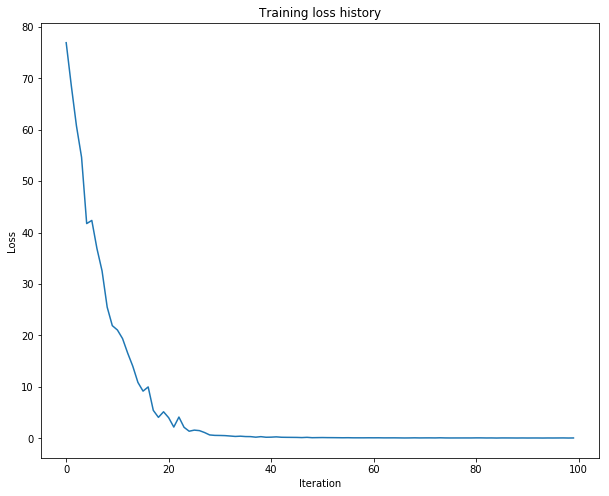

In [22]:
np.random.seed(231)

small_data = load_coco_data(max_train=50)

small_rnn_model = CaptioningRNN(
          cell_type='rnn',
          word_to_idx=data['word_to_idx'],
          input_dim=data['train_features'].shape[1],
          hidden_dim=512,
          wordvec_dim=256,
        )

small_rnn_solver = CaptioningSolver(small_rnn_model, small_data,
           update_rule='adam',
           num_epochs=50,
           batch_size=25,
           optim_config={
             'learning_rate': 5e-3,
           },
           lr_decay=0.95,
           verbose=True, print_every=10,
         )

small_rnn_solver.train()

# Plot the training losses
plt.plot(small_rnn_solver.loss_history)
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.title('Training loss history')
plt.show()

# Test-time sampling
Unlike classification models, image captioning models behave very differently at training time and at test time. At training time, we have access to the ground-truth caption, so we feed ground-truth words as input to the RNN at each timestep. At test time, we sample from the distribution over the vocabulary at each timestep, and feed the sample as input to the RNN at the next timestep.

In the file `cs231n/classifiers/rnn.py`, implement the `sample` method for test-time sampling. After doing so, run the following to sample from your overfitted model on both training and validation data. The samples on training data should be very good; the samples on validation data probably won't make sense.

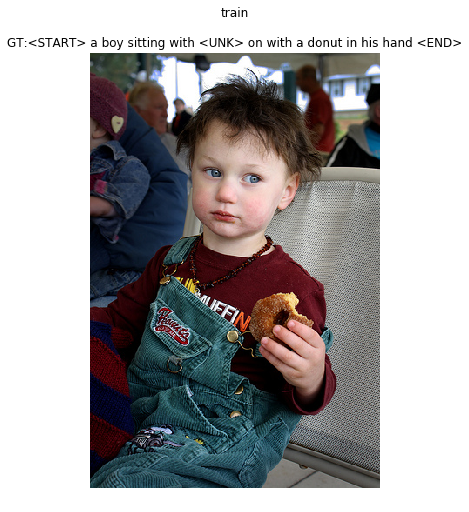

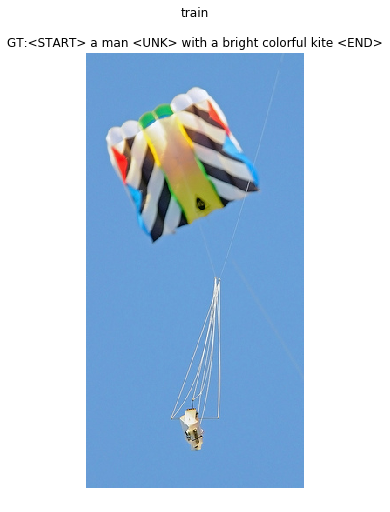

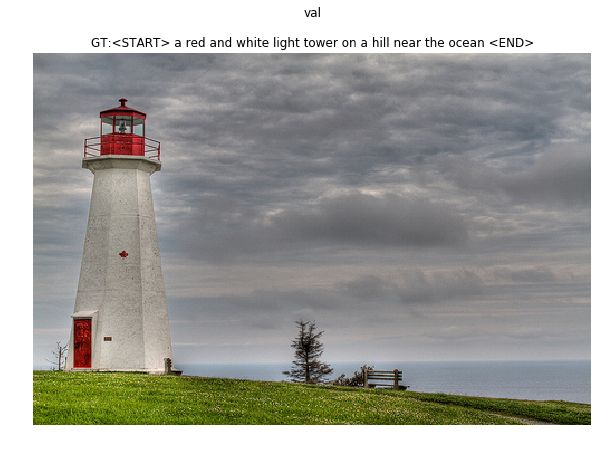

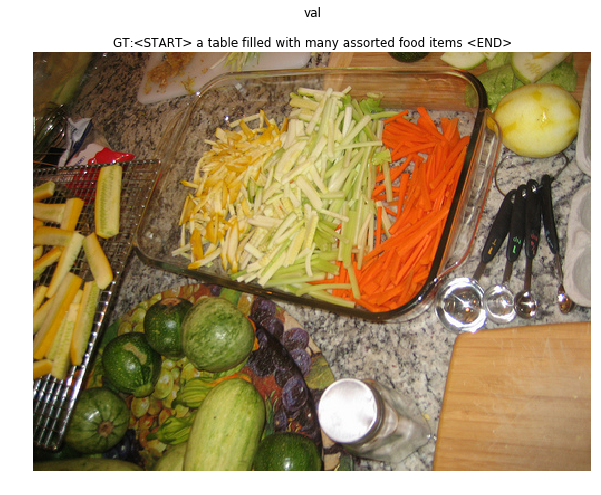

In [23]:
for split in ['train', 'val']:
    minibatch = sample_coco_minibatch(small_data, split=split, batch_size=2)
    gt_captions, features, urls = minibatch
    gt_captions = decode_captions(gt_captions, data['idx_to_word'])

    sample_captions = small_rnn_model.sample(features)
    sample_captions = decode_captions(sample_captions, data['idx_to_word'])

    for gt_caption, sample_caption, url in zip(gt_captions, sample_captions, urls):
        plt.imshow(image_from_url(url))
        plt.title('%s\n%s\nGT:%s' % (split, sample_caption, gt_caption))
        plt.axis('off')
        plt.show()